# **Projet 5 :** Segmentez des clients d'un site e-commerce

## Notebook d'analyse des modèle de clustering

### Imports

In [1]:
from unidecode import unidecode

In [2]:
%pylab inline
import pandas as pd
import missingno as msno

Populating the interactive namespace from numpy and matplotlib


In [3]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn import cluster,  mixture

### Configuration

In [4]:
%load_ext autoreload
%autoreload 2

# configurations pandas
pd.set_option('display.max_rows', 250)
pd.set_option('display.max_columns', 250)

### Chargement des données par SQL

In [5]:
DATABASE_URL = 'sqlite:///./db/olist.db'
with open('./db/script.sql', 'r') as file:
    query = file.read()
df = pd.read_sql(sql=query, con=DATABASE_URL)
df.set_index('customer_unique_id', inplace=True)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 94457 entries, ('0000366f3b9a7992bf8c76cfdf3221e2', '0000366f3b9a7992bf8c76cfdf3221e2') to ('ffffd2657e2aad2907e67c3e9daecbeb', 'ffffd2657e2aad2907e67c3e9daecbeb')
Data columns (total 54 columns):
 #   Column                                      Non-Null Count  Dtype  
---  ------                                      --------------  -----  
 0   order_id_count                              94457 non-null  int64  
 1   order_status_delivered                      94457 non-null  int64  
 2   order_status_invoiced                       94457 non-null  int64  
 3   order_status_shipped                        94457 non-null  int64  
 4   order_status_processing                     94457 non-null  int64  
 5   order_status_unavailable                    94457 non-null  int64  
 6   order_status_canceled                       94457 non-null  int64  
 7   order_status_created                        94457 non-null  int64  
 8   order_status_approved  

In [7]:
df.head()

,order_id_count,order_status_delivered,order_status_invoiced,order_status_shipped,order_status_processing,order_status_unavailable,order_status_canceled,order_status_created,order_status_approved,order_diff_now_purchase_date_min,order_diff_now_purchase_date_max,order_diff_now_purchase_date_mean,order_diff_purchase_delivered_date_min,order_diff_purchase_delivered_date_max,order_diff_purchase_delivered_date_mean,order_diff_estimated_delivered_date_min,order_diff_estimated_delivered_date_max,order_diff_estimated_delivered_date_mean,order_items_count_sum,order_items_count_mean,product_category_name_distinct_count_mean,product_name_lenght_mean_mean,product_description_lenght_mean_mean,product_photos_qty_mean_mean,product_weight_g_mean_mean,product_volume_cm3_mean_mean,seller_zip_code_prefix_list,seller_zip_code_prefix_distinct_count_mean,shipping_limit_date_mean_mean,price_mean_mean,price_sum,freight_value_mean_mean,reviews_count_sum,reviews_count_mean,review_score_mean_mean,review_message_mean_mean,payments_count_sum,payments_count_mean,payment_credit_card_sum,payment_credit_card_mean,payment_debit_sum,payment_debit_mean,payment_boleto_sum,payment_boleto_mean,payment_voucher_sum,payment_voucher_mean,payment_not_defined_sum,payment_not_defined_mean,payment_installments_mean_mean,payment_value_mean_mean,payment_value_sum,customer_zip_code_prefix,geolocation_city,geolocation_state
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
"(0000366f3b9a7992bf8c76cfdf3221e2, 0000366f3b9a7992bf8c76cfdf3221e2)",1,1,0,0,0,0,0,0,0,124635813,124635813,124635813.0,163293,163293,163293.0,-747720,-747720,-747720.0,1,1.0,1.0,60.0,236.0,1.0,1500.0,7616.0,13405,1.0,1.526383e+09,129.90,129.90,12.00,1,1.0,5.0,111.0,1,1.0,1,1.0,0,0.0,0,0.0,0,0.0,0,0.0,8.0,141.90,141.90,7787,cajamar,sp
"(0000b849f77a49e4a4ce2b2a4ca5be3f, 0000b849f77a49e4a4ce2b2a4ca5be3f)",1,1,0,0,0,0,0,0,0,124894113,124894113,124894113.0,176793,176793,176793.0,-474120,-474120,-474120.0,1,1.0,1.0,56.0,635.0,1.0,375.0,5148.0,2215,1.0,1.526061e+09,18.90,18.90,8.29,1,1.0,4.0,0.0,1,1.0,1,1.0,0,0.0,0,0.0,0,0.0,0,0.0,1.0,27.19,27.19,6053,osasco,sp
"(0000f46a3911fa3c0805444483337064, 0000f46a3911fa3c0805444483337064)",1,1,0,0,0,0,0,0,0,161405697,161405697,161405697.0,230007,230007,230007.0,-2113290,-2113290,-2113290.0,1,1.0,1.0,49.0,177.0,3.0,1500.0,43750.0,13232,1.0,1.489612e+09,69.00,69.00,17.22,1,1.0,3.0,0.0,1,1.0,1,1.0,0,0.0,0,0.0,0,0.0,0,0.0,8.0,86.22,86.22,88115,sao jose,sc
"(0000f6ccb0745a6a4b88665a16c9f078, 0000f6ccb0745a6a4b88665a16c9f078)",1,1,0,0,0,0,0,0,0,142745419,142745419,142745419.0,85118,85118,85118.0,-2605901,-2605901,-2605901.0,1,1.0,1.0,43.0,1741.0,5.0,150.0,1045.0,3569,1.0,1.508363e+09,25.99,25.99,17.63,1,1.0,4.0,12.0,1,1.0,1,1.0,0,0.0,0,0.0,0,0.0,0,0.0,4.0,43.62,43.62,66812,belem,pa
"(0004aac84e0df4da2b147fca70cf8255, 0004aac84e0df4da2b147fca70cf8255)",1,1,0,0,0,0,0,0,0,139896858,139896858,139896858.0,173188,173188,173188.0,-1570070,-1570070,-1570070.0,1,1.0,1.0,58.0,794.0,3.0,6050.0,528.0,12327,1.0,1.511381e+09,180.00,180.00,16.89,1,1.0,5.0,0.0,1,1.0,1,1.0,0,0.0,0,0.0,0,0.0,0,0.0,6.0,196.89,196.89,18040,sorocaba,sp


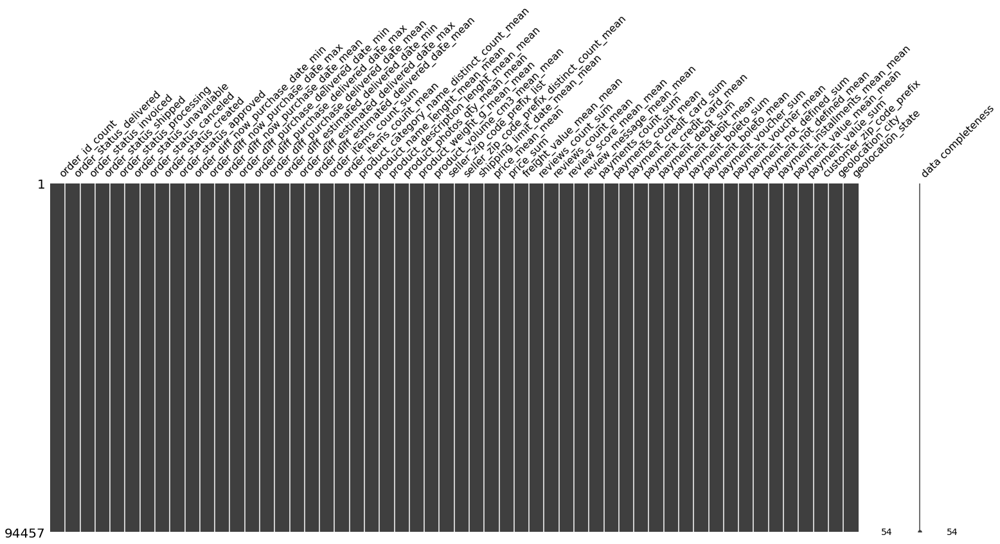

In [8]:
_ = msno.matrix(df, labels=True)

### Suppression des colonnes de types **object**

In [6]:
df.drop(columns=df.select_dtypes(['object']).columns, axis=1, inplace=True)

### Exploration des données

In [10]:
df.describe()

,order_id_count,order_status_delivered,order_status_invoiced,order_status_shipped,order_status_processing,order_status_unavailable,order_status_canceled,order_status_created,order_status_approved,order_diff_now_purchase_date_min,order_diff_now_purchase_date_max,order_diff_now_purchase_date_mean,order_diff_purchase_delivered_date_min,order_diff_purchase_delivered_date_max,order_diff_purchase_delivered_date_mean,order_diff_estimated_delivered_date_min,order_diff_estimated_delivered_date_max,order_diff_estimated_delivered_date_mean,order_items_count_sum,order_items_count_mean,product_category_name_distinct_count_mean,product_name_lenght_mean_mean,product_description_lenght_mean_mean,product_photos_qty_mean_mean,product_weight_g_mean_mean,product_volume_cm3_mean_mean,seller_zip_code_prefix_distinct_count_mean,shipping_limit_date_mean_mean,price_mean_mean,price_sum,freight_value_mean_mean,reviews_count_sum,reviews_count_mean,review_score_mean_mean,review_message_mean_mean,payments_count_sum,payments_count_mean,payment_credit_card_sum,payment_credit_card_mean,payment_debit_sum,payment_debit_mean,payment_boleto_sum,payment_boleto_mean,payment_voucher_sum,payment_voucher_mean,payment_not_defined_sum,payment_not_defined_mean,payment_installments_mean_mean,payment_value_mean_mean,payment_value_sum
count,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.0,94457.000000,9.445700e+04,9.445700e+04,9.445700e+04,9.445700e+04,9.445700e+04,9.445700e+04,9.445700e+04,9.445700e+04,9.445700e+04,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,9.445700e+04,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.000000,94457.0,94457.0,94457.000000,94457.000000,94457.000000
mean,1.033751,1.011783,0.003240,0.010841,0.003113,0.000064,0.004690,0.0,0.000021,1.356248e+08,1.358552e+08,1.357402e+08,5.839954e+05,6.083119e+05,5.956626e+05,-1.472952e+06,-1.437888e+06,-1.455802e+06,1.179447,1.138375,1.007872,48.136822,784.513245,2.223225,2105.905490,15232.517808,1.011585,1.515414e+09,126.372853,142.178980,20.219613,1.039531,1.003193,4.102441,28.131954,1.079814,1.044081,0.799115,0.773008,0.016028,0.015617,0.205554,0.199129,0.059117,0.056327,0.0,0.0,2.901194,158.183656,165.778104
std,0.210627,0.253415,0.056825,0.104268,0.055703,0.007970,0.068323,0.0,0.004601,1.323518e+07,1.327810e+07,1.321190e+07,3.104536e+06,3.189403e+06,3.123653e+06,3.168944e+06,3.247936e+06,3.185348e+06,0.616279,0.522361,0.088764,11.387897,652.637210,1.743782,3741.769772,23271.548590,0.110985,1.317718e+07,190.475450,216.537157,15.820573,0.252211,0.049520,1.326356,47.934740,0.459152,0.374889,0.473991,0.424938,0.126927,0.123576,0.418117,0.398524,0.443513,0.413911,0.0,0.0,2.675889,217.305069,227.189572
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,1.146200e+08,1.150308e+08,1.150308e+08,-1.479275e+07,-1.479275e+07,-1.479275e+07,-1.662630e+07,-1.662630e+07,-1.662630e+07,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.474244e+09,0.850000,0.850000,0.000000,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,1.856818,9.590000
25%,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,1.248877e+08,1.251212e+08,1.250567e+08,9.686000e+04,9.894900e+04,9.864700e+04,-2.215352e+06,-2.194955e+06,-2.199630e+06,1.000000,1.000000,1.000000,42.000000,348.000000,1.000000,300.000000,2856.000000,1.000000,1.505989e+09,42.900000,47.800000,13.370000,1.000000,1.000000,4.000000,0.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,1.000000,60.730000,63.100000
50%,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0

In [11]:
# transformer toutes les dates en jours
timestamp_columns = [
    'order_diff_now_purchase_date_min',
    'order_diff_now_purchase_date_max',
    'order_diff_now_purchase_date_mean',
    'order_diff_purchase_delivered_date_min',
    'order_diff_purchase_delivered_date_max',
    'order_diff_purchase_delivered_date_mean',
    'order_diff_estimated_delivered_date_min',
    'order_diff_estimated_delivered_date_max',
    'order_diff_estimated_delivered_date_mean'
]
df[timestamp_columns] = df[timestamp_columns] / (60 * 60 * 24)

In [12]:
# Nombre de commandes > 1 par customer
len(df[df['order_id_count'] > 1])/df.shape[0]

0.030288914532538614

### Réduction et centrage des données

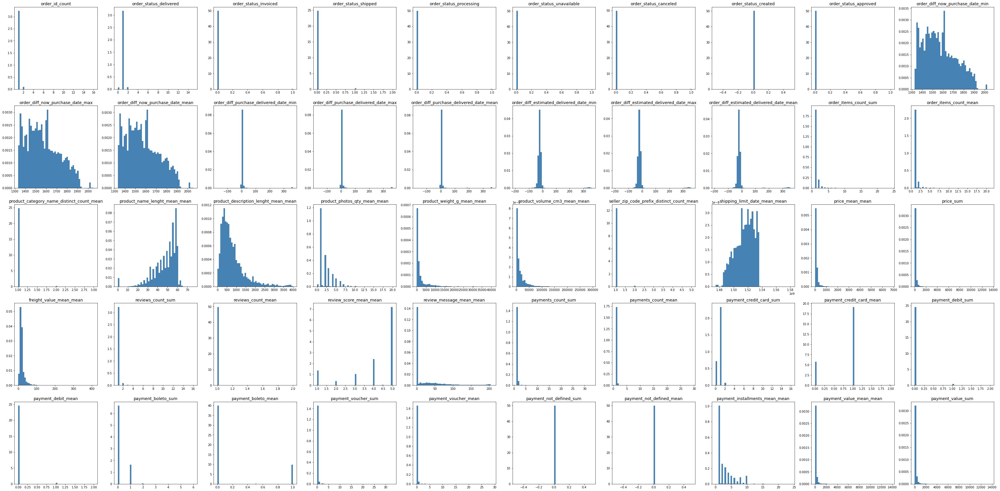

In [13]:
fig = plt.figure(figsize=(60, 30))
for i, c in enumerate(df.columns):
    ax = fig.add_subplot(5, 10, (i+1))
    h = ax.hist(df[c], bins=50, color='steelblue', density=True, edgecolor='none')
    ax.set_title(c, fontsize=14)

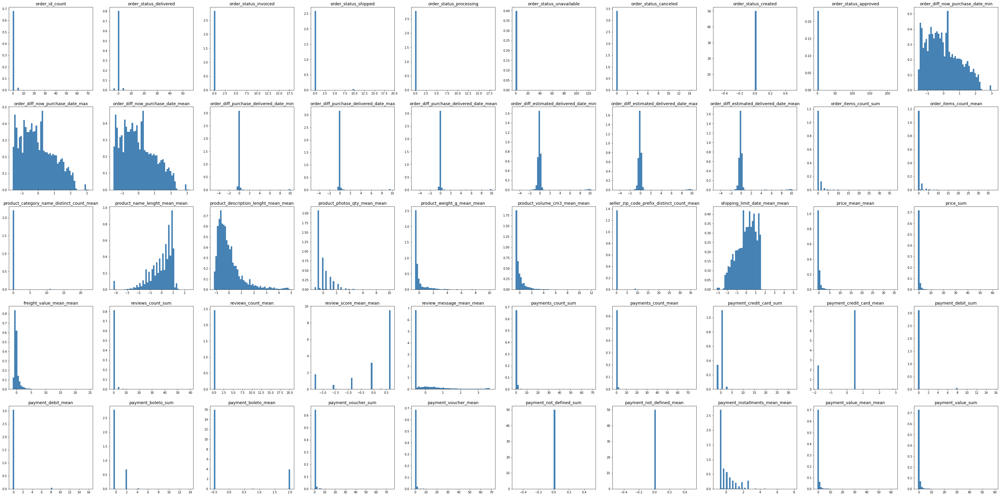

In [14]:
scaler = StandardScaler()
data_scaled = scaler.fit_transform(df)

fig = plt.figure(figsize=(60, 30))
for i, c in enumerate(df.columns):
    ax = fig.add_subplot(5, 10, (i+1))
    h = ax.hist(data_scaled[:,i], bins=50, color='steelblue', density=True, edgecolor='none')
    ax.set_title(c, fontsize=14)

### Analyse en composantes principales (2 axes)

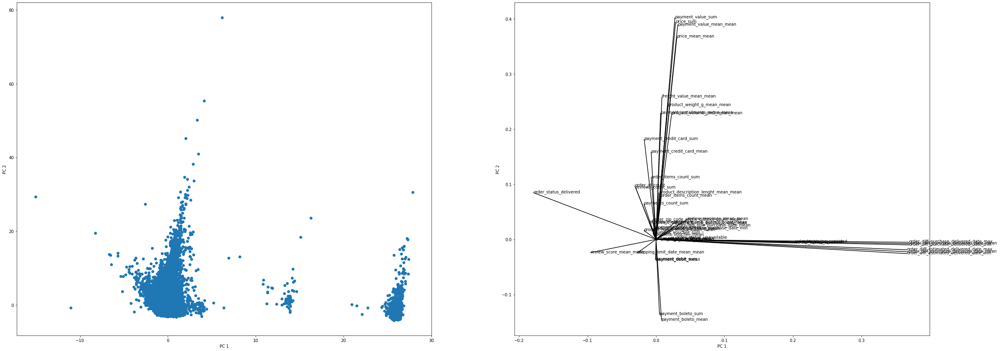

In [15]:
pca = PCA(n_components=2)
data_reduced = pca.fit_transform(data_scaled)

fig, ax = plt.subplots(1, 2)
fig.set_figheight(15)
fig.set_figwidth(40)
ax[0].scatter(data_reduced[:,0], data_reduced[:,1])
ax[0].set_xlabel('PC 1')
ax[0].set_ylabel('PC 2')

pcs = pca.components_
for i, (x, y) in enumerate(zip(pcs[0,:], pcs[1,:])):
    ax[1].plot([0,x],[0,y], color = 'k')
    ax[1].text(x, y, df.columns[i])
    ax[1].set_xlabel('PC 1')
    ax[1].set_ylabel('PC 2')
plt.show()

In [16]:
# Tri par importance des vecteurs
_pca_score = pd.DataFrame(data={'column': df.columns, 'pc1':pca.components_[0], 'pc2':pca.components_[1]})
_pca_score['norme2'] = _pca_score['pc1']**2 + _pca_score['pc2']**2
_pca_score.sort_values('norme2', ascending=False, inplace=True, ignore_index=True)
_pca_score

,column,pc1,pc2,norme2
0,payment_value_sum,0.027631,0.401942,0.162321
1,price_sum,0.028551,0.393793,0.155888
2,payment_value_mean_mean,0.031719,0.389116,0.152417
3,order_diff_purchase_delivered_date_mean,0.372136,-0.007750,0.138545
4,order_diff_purchase_delivered_date_max,0.369699,-0.005224,0.136705
5,order_diff_purchase_delivered_date_min,0.369485,-0.009945,0.136618
6,order_diff_estimated_delivered_date_mean,0.368900,-0.022507,0.136594
7,price_mean_mean,0.030540,0.367571,0.136041
8,order_diff_estimated_delivered_date_min,0.366434,-0.025742,0.134936
9,order_diff_estimated_delivered_date_max,0.366487,-0.018863,0.134669


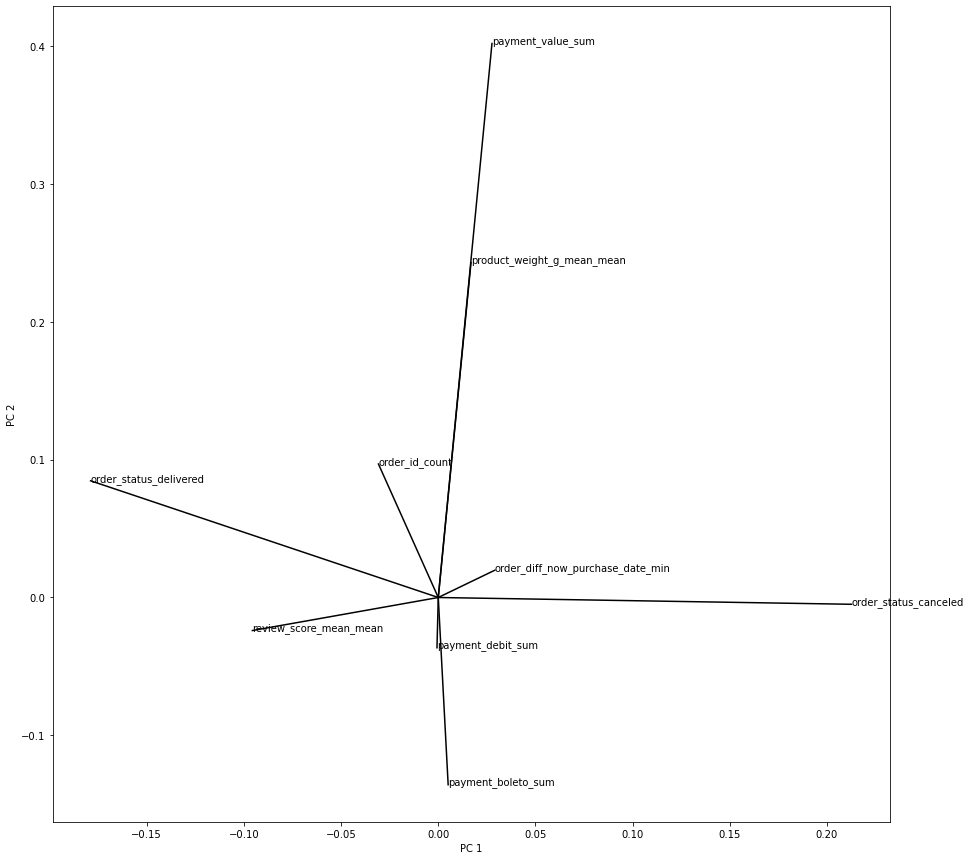

In [17]:
column_most_important = [
    'order_id_count',
    'order_status_delivered',
    'order_status_canceled',
    'order_diff_now_purchase_date_min',
    'product_weight_g_mean_mean',
    'review_score_mean_mean',
    'payment_debit_sum',
    'payment_boleto_sum',
    'payment_value_sum'
]

pcs = pca.components_
plt.figure(figsize=(15,15))
for i, (x, y) in enumerate(zip(pcs[0,:], pcs[1,:])):
    if df.columns[i] not in column_most_important:
        continue
    plt.plot([0,x],[0,y], color = 'k')
    plt.text(x, y, df.columns[i])
    plt.xlabel('PC 1')
    plt.ylabel('PC 2')
plt.show()

### Analyse de la répartition des variables sur les 2 axes

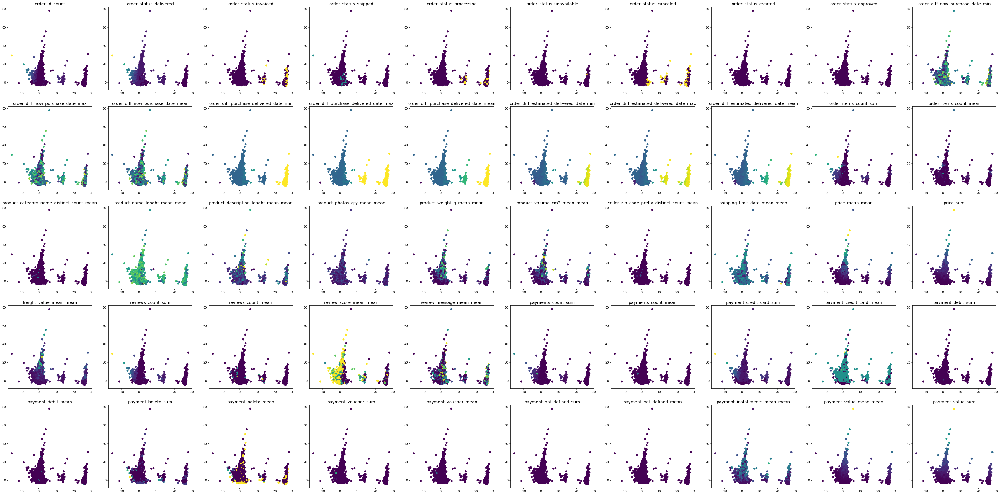

In [18]:
fig = plt.figure(figsize=(60, 30))
for i, c in enumerate(df.columns):
    ax = fig.add_subplot(5, 10, (i+1))
    h = ax.scatter(x=data_reduced[:,0], y=data_reduced[:,1], c=data_scaled[:,i], cmap='viridis')
    ax.set_title(c, fontsize=14)

### Kmean

#### Kmean avec toutes les variables

In [1]:
import pandas as pd
%pylab inline

%load_ext autoreload
%autoreload 2

DATABASE_URL = 'sqlite:///./db/olist.db'
with open('./db/script.sql', 'r') as file:
    query = file.read()
df = pd.read_sql(sql=query, con=DATABASE_URL)

df.drop(columns=df.select_dtypes(['object']).columns, axis=1, inplace=True)

#limit=10000
limit=None  # pour toutes les données

Populating the interactive namespace from numpy and matplotlib


For 2 clusters, The average silhouette_score is : 0.768074170071352
For 3 clusters, The average silhouette_score is : 0.24544806160130345
For 4 clusters, The average silhouette_score is : 0.24564819279553213
For 5 clusters, The average silhouette_score is : 0.25702938002761977
For 6 clusters, The average silhouette_score is : 0.17703903078188463
For 7 clusters, The average silhouette_score is : 0.1903520586518638
For 8 clusters, The average silhouette_score is : 0.19441209855573097
For n_clusters = 2 The average distortion is : 3795664.0671787686
For n_clusters = 3 The average distortion is : 3447249.597910557
For n_clusters = 4 The average distortion is : 3219521.5206881356
For n_clusters = 5 The average distortion is : 2980217.6132777776
For n_clusters = 6 The average distortion is : 2793154.4777934495
For n_clusters = 7 The average distortion is : 2649681.1198356994
For n_clusters = 8 The average distortion is : 2436924.7951102606


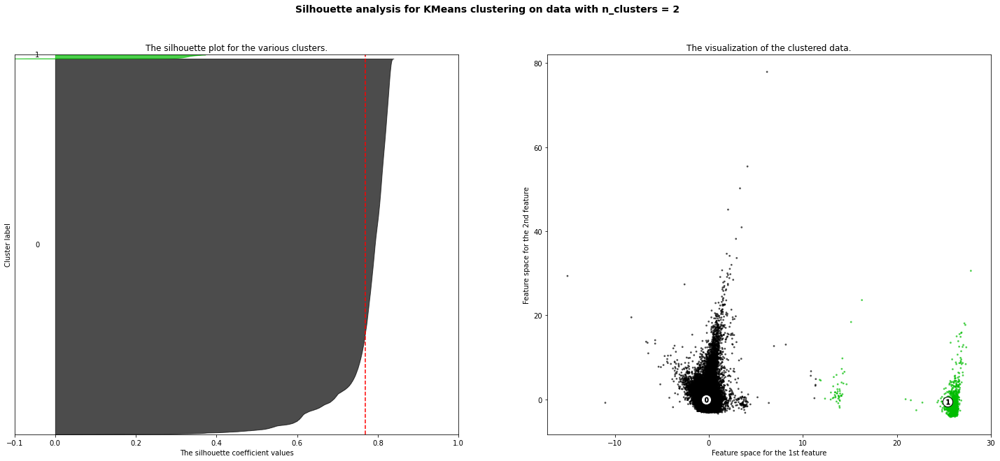

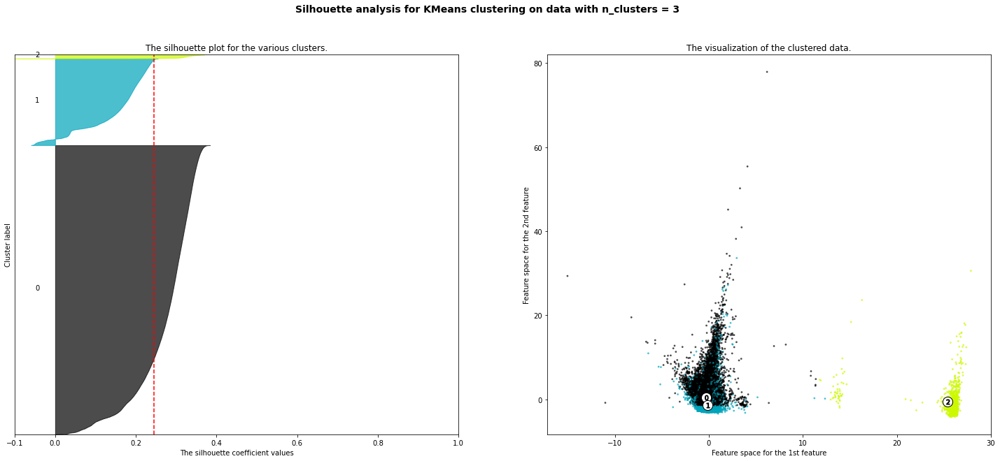

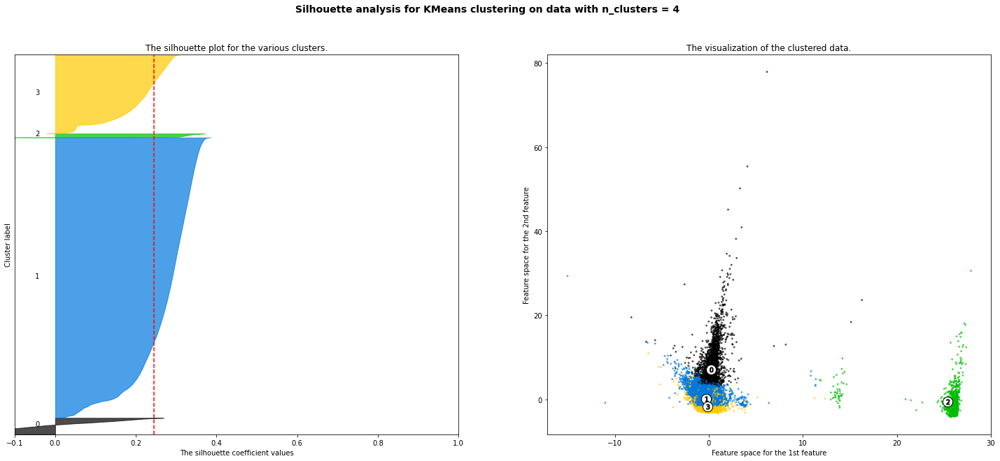

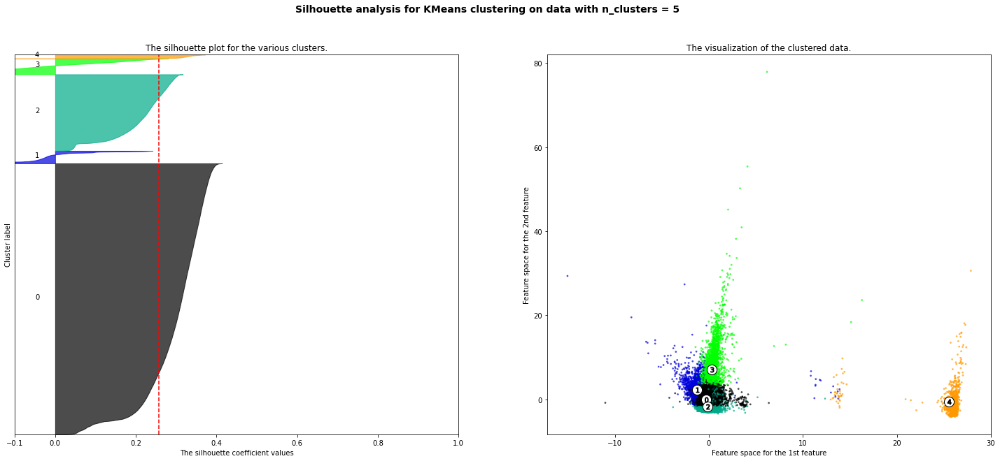

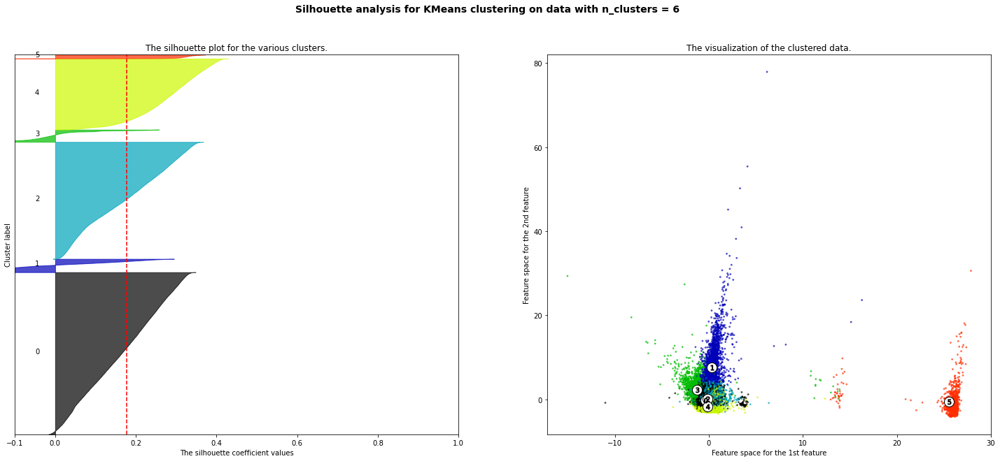

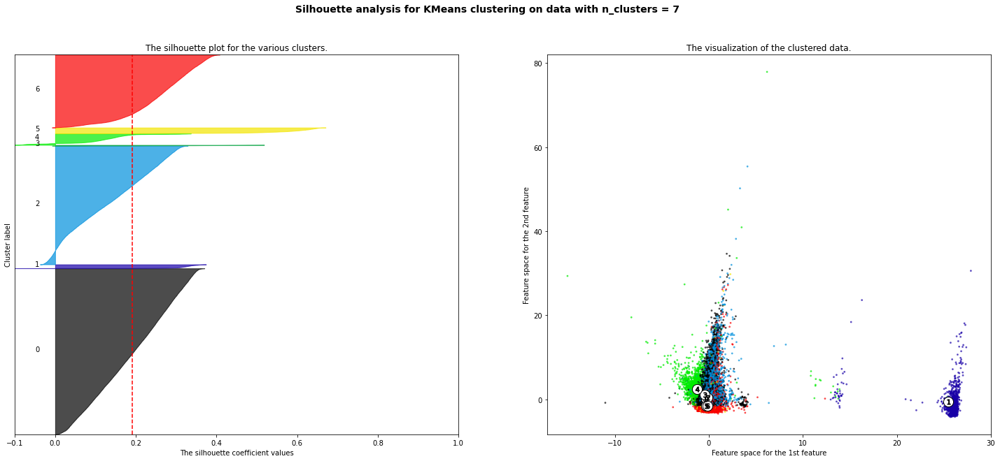

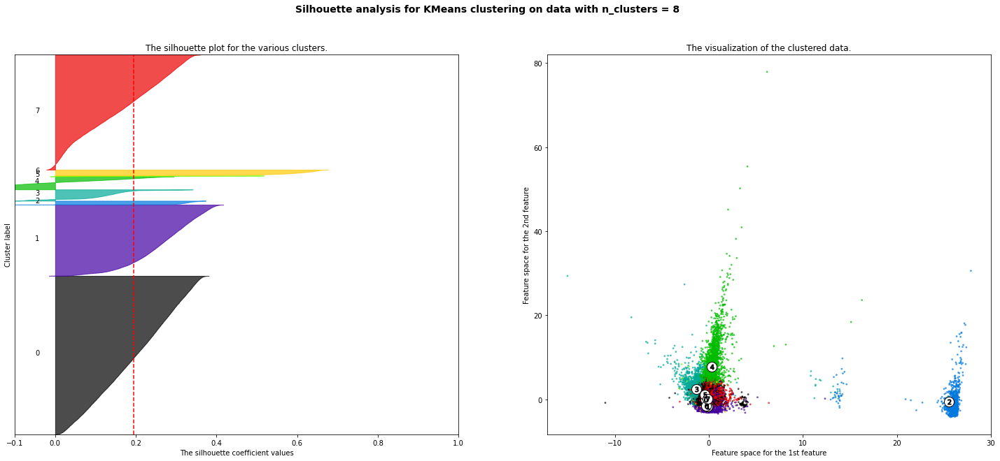

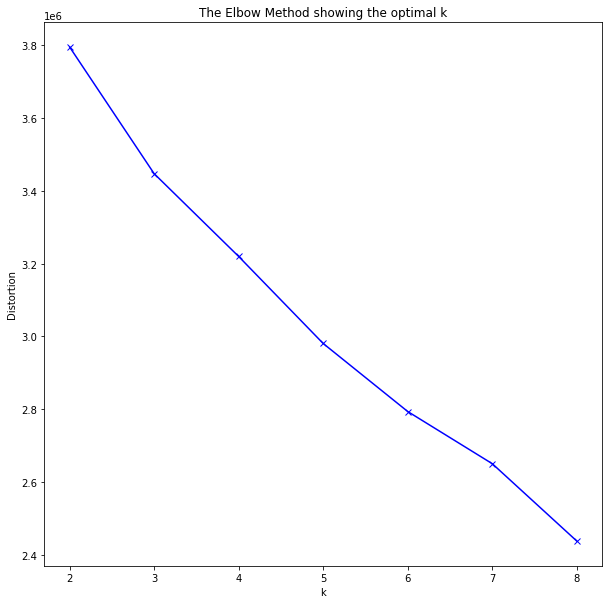

In [20]:
from src.cluster import dataHelper, kmeanHelper

data_helper = dataHelper(df=df, limit=limit)
kmean_helper = kmeanHelper(data=data_helper)
kmean_helper.make_clusters(nx=range(2, 9))
kmean_helper.plot_results(nx=range(2, 9))
kmean_helper.plot_elbow()

#### Kmean avec 3 variables
* payment_value
* order_id_count
* diff_now_purchase

Making clusters: 2
Making clusters: 3
Making clusters: 4
Making clusters: 5
Making clusters: 6
Making clusters: 7
Making clusters: 8
For 2 clusters, The average silhouette_score is : 0.7375053379353294
For 3 clusters, The average silhouette_score is : 0.45563355581679543
For 4 clusters, The average silhouette_score is : 0.4883290952329935
For 5 clusters, The average silhouette_score is : 0.4175834119553607
For 6 clusters, The average silhouette_score is : 0.4358691570177719
For 7 clusters, The average silhouette_score is : 0.4403144964476308
For 8 clusters, The average silhouette_score is : 0.4480174565052763
For n_clusters = 2 The average distortion is : 204391.19490524672
For n_clusters = 3 The average distortion is : 139773.79669016393
For n_clusters = 4 The average distortion is : 93404.32022318743
For n_clusters = 5 The average distortion is : 78589.74085768513
For n_clusters = 6 The average distortion is : 64396.08146720755
For n_clusters = 7 The average distortion is : 54844.033

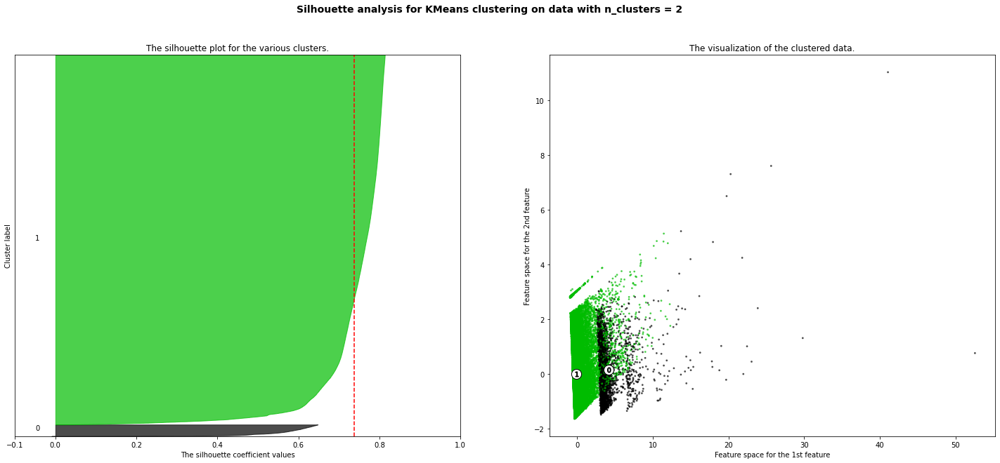

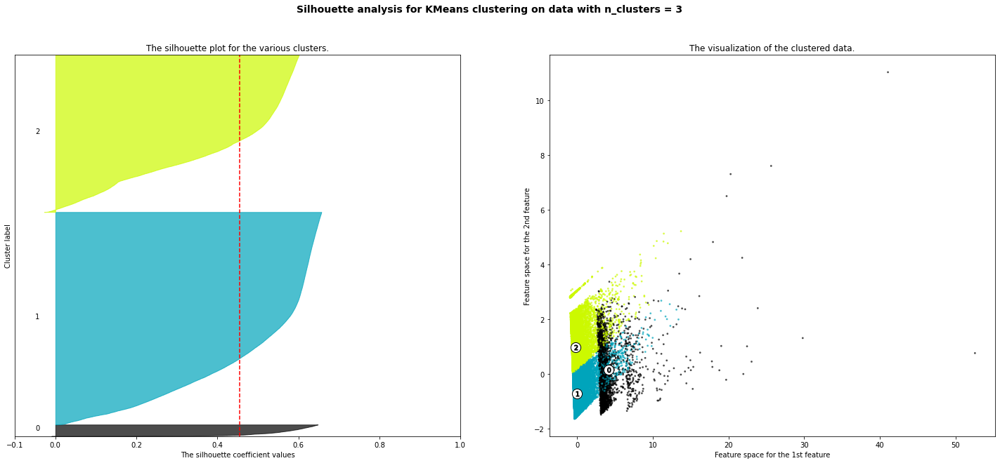

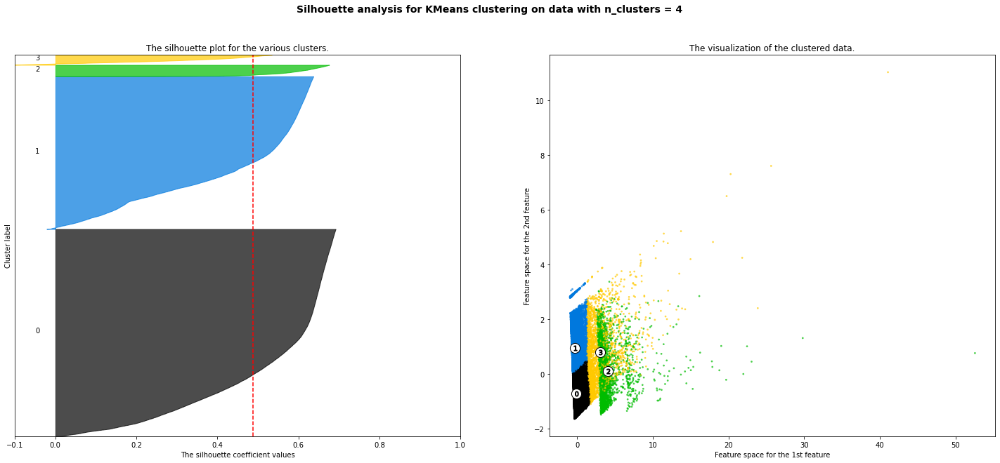

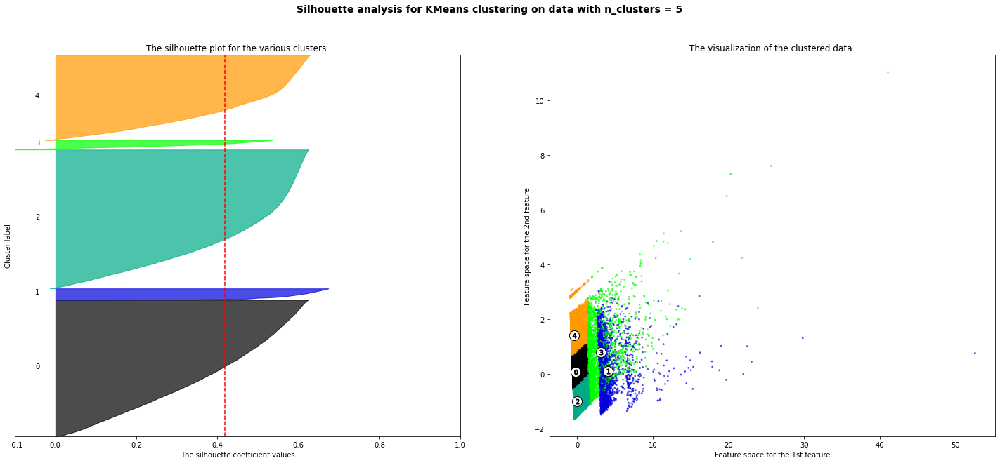

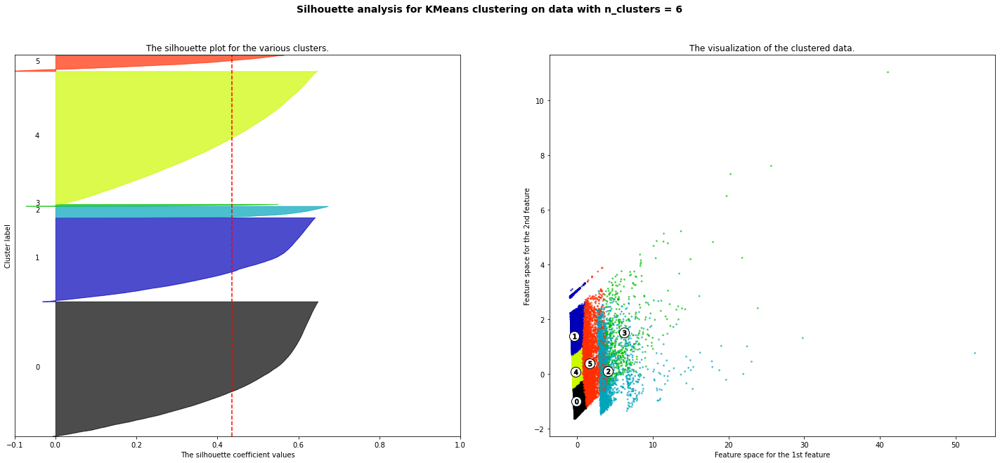

...

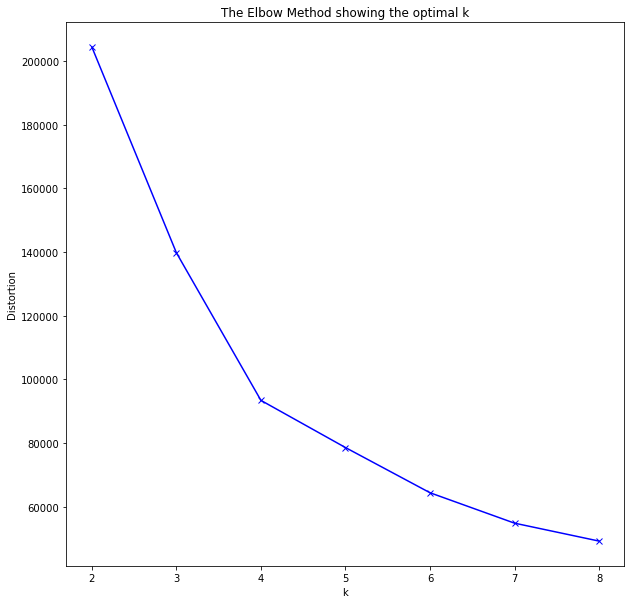

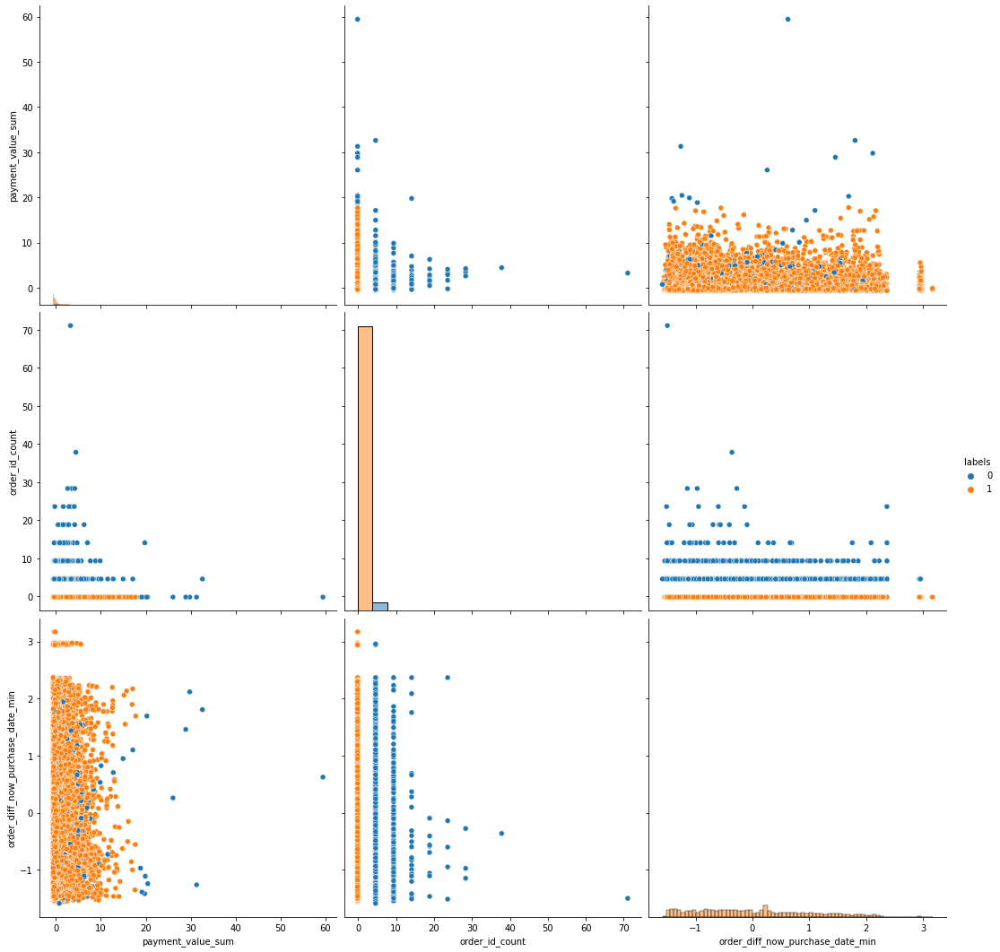

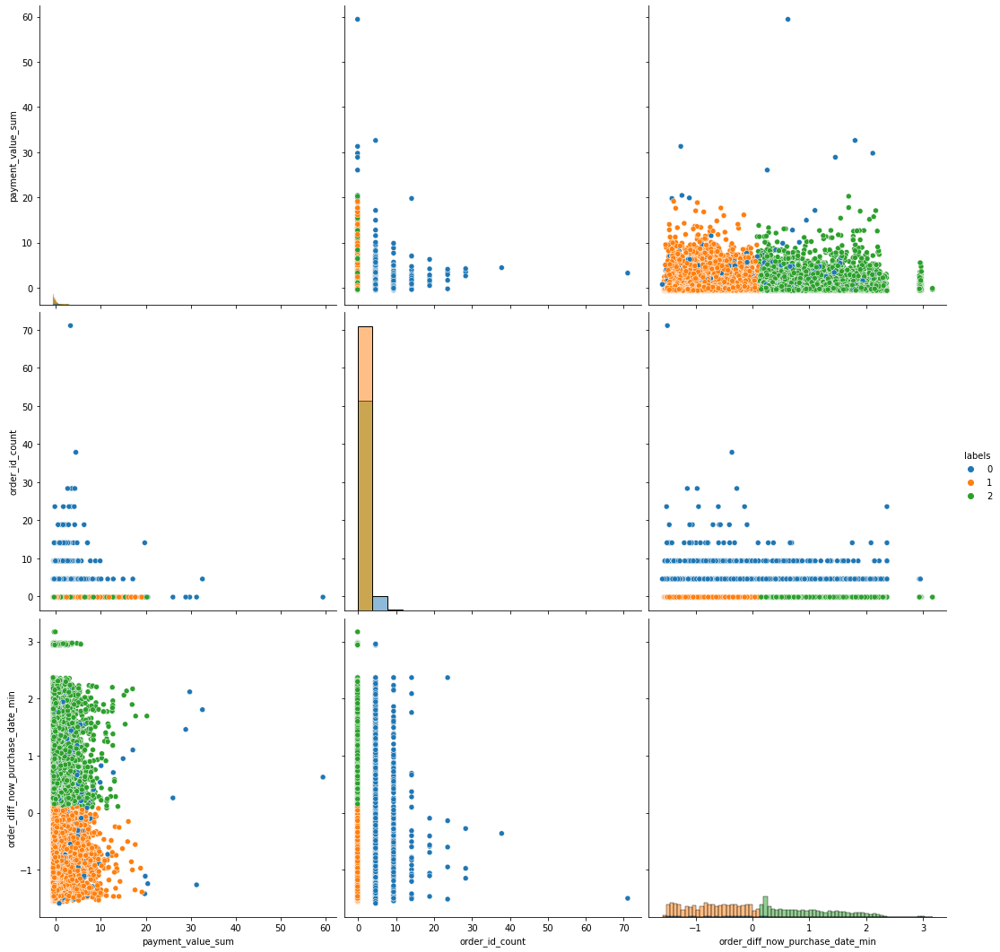

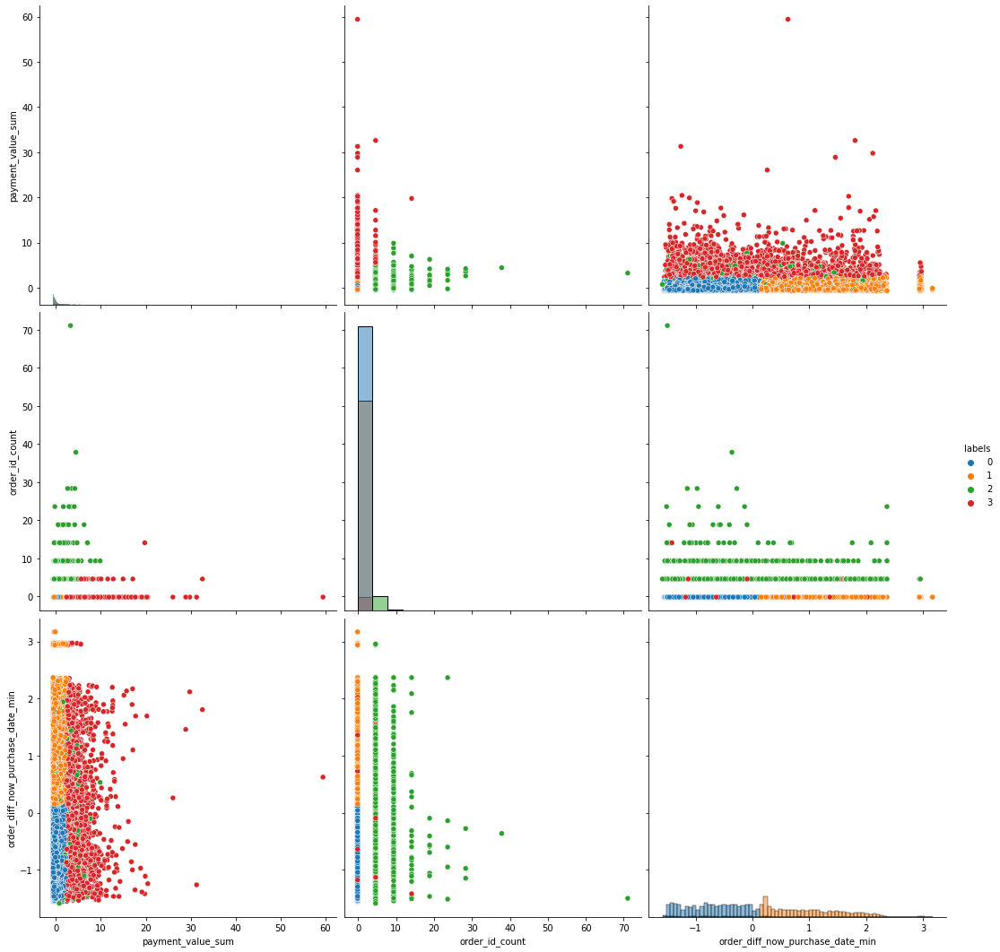

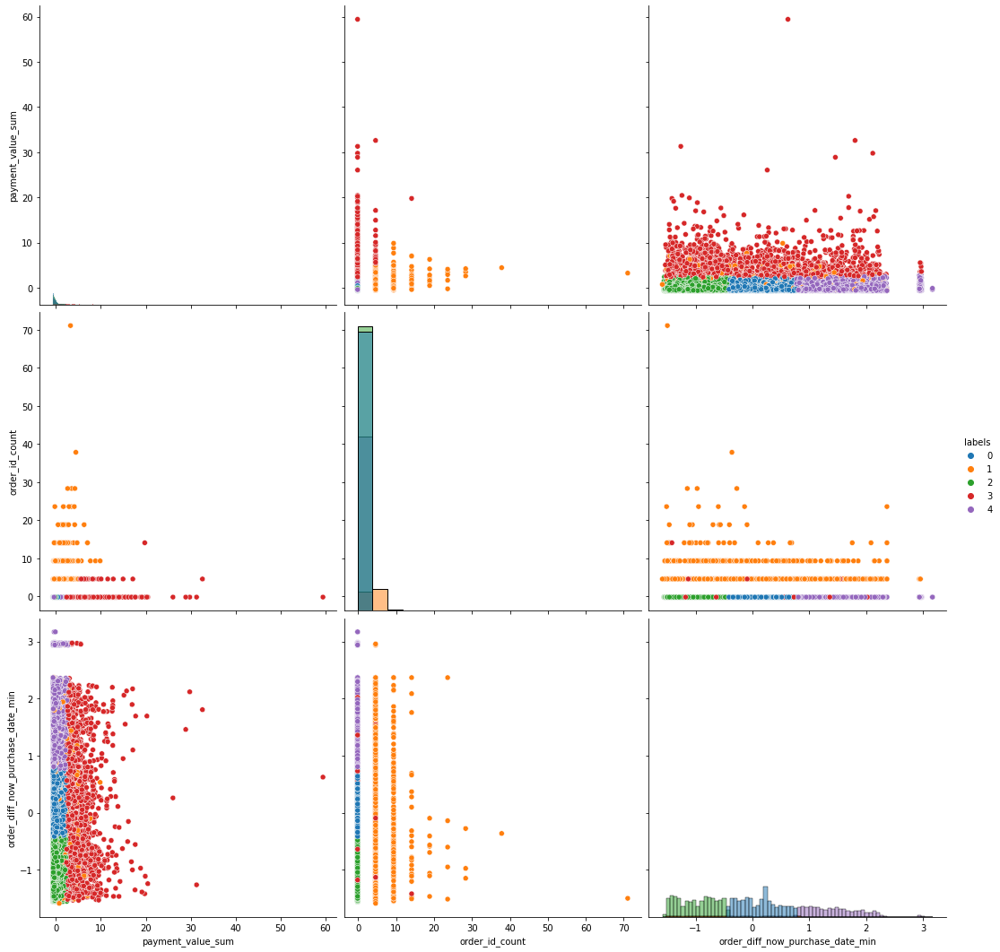

In [8]:
from src.cluster import dataHelper, kmeanHelper

columns = [
    'payment_value_sum',
    'order_id_count',
    'order_diff_now_purchase_date_min'
]

data_helper = dataHelper(df=df[columns], limit=limit)
kmean_helper = kmeanHelper(data=data_helper)
kmean_helper.make_clusters(nx=range(2, 9))
kmean_helper.plot_results(nx=range(2, 9))
kmean_helper.plot_elbow()
kmean_helper.plot_relationship(n=2)
kmean_helper.plot_relationship(n=3)
kmean_helper.plot_relationship(n=4)
kmean_helper.plot_relationship(n=5)

#### Kmean avec 4 variables
* payment_value
* order_id_count
* diff_now_purchase
* review score

Making clusters: 2
Making clusters: 3
Making clusters: 4
Making clusters: 5
Making clusters: 6
Making clusters: 7
Making clusters: 8
For 2 clusters, The average silhouette_score is : 0.6576014801418812
For 3 clusters, The average silhouette_score is : 0.4124041267238487
For 4 clusters, The average silhouette_score is : 0.39513932067026936
For 5 clusters, The average silhouette_score is : 0.4178393179083157
For 6 clusters, The average silhouette_score is : 0.4247201072346247
For 7 clusters, The average silhouette_score is : 0.3515280698718891
For 8 clusters, The average silhouette_score is : 0.3519113630969361
For n_clusters = 2 The average distortion is : 298843.83174661675
For n_clusters = 3 The average distortion is : 223776.90726875546
For n_clusters = 4 The average distortion is : 169120.611887464
For n_clusters = 5 The average distortion is : 124838.83491700552
For n_clusters = 6 The average distortion is : 111830.35345965203
For n_clusters = 7 The average distortion is : 99789.47

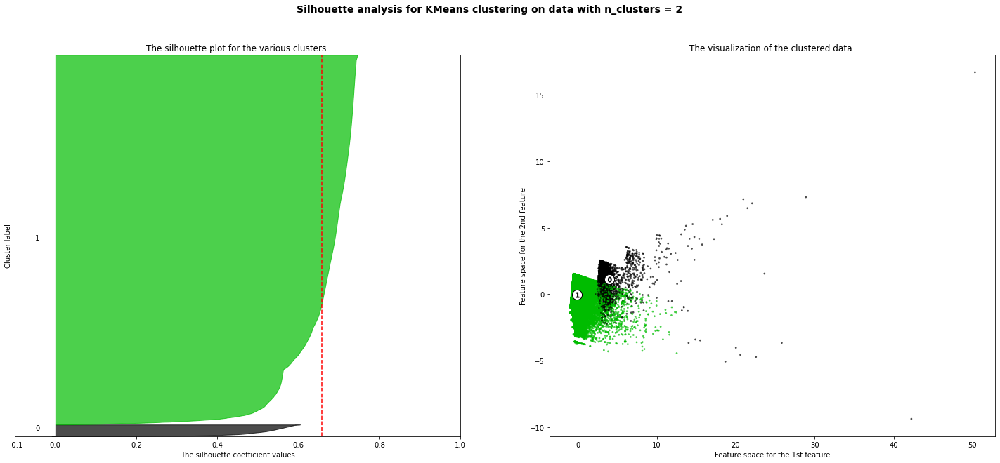

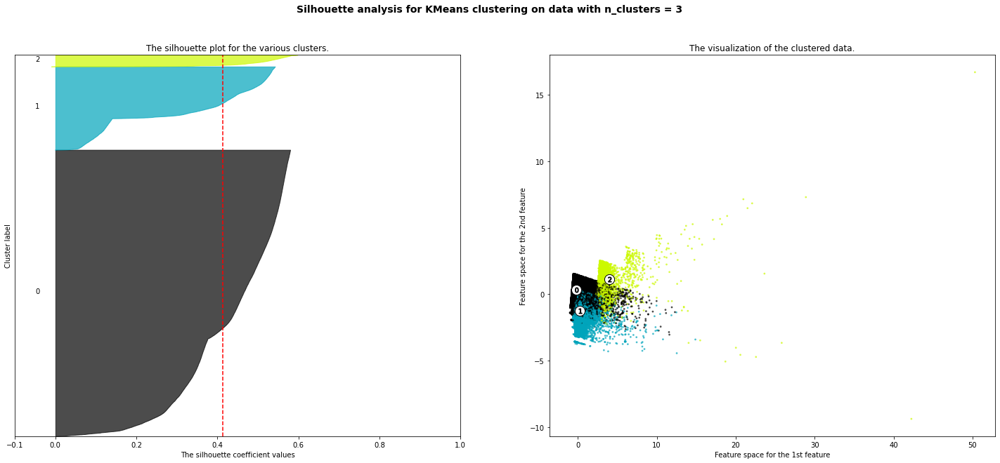

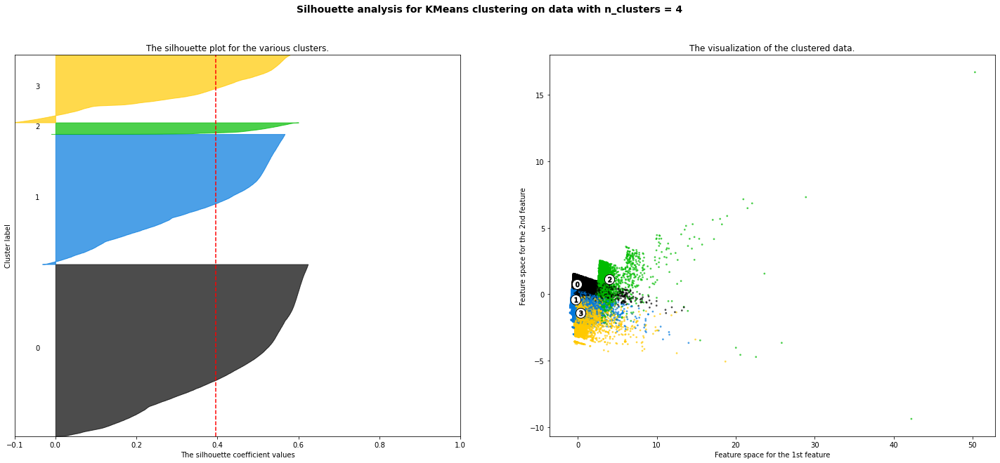

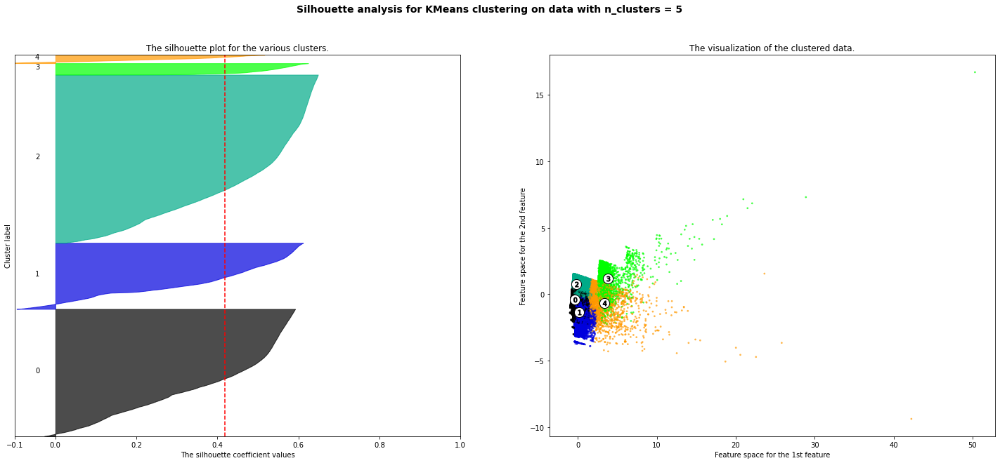

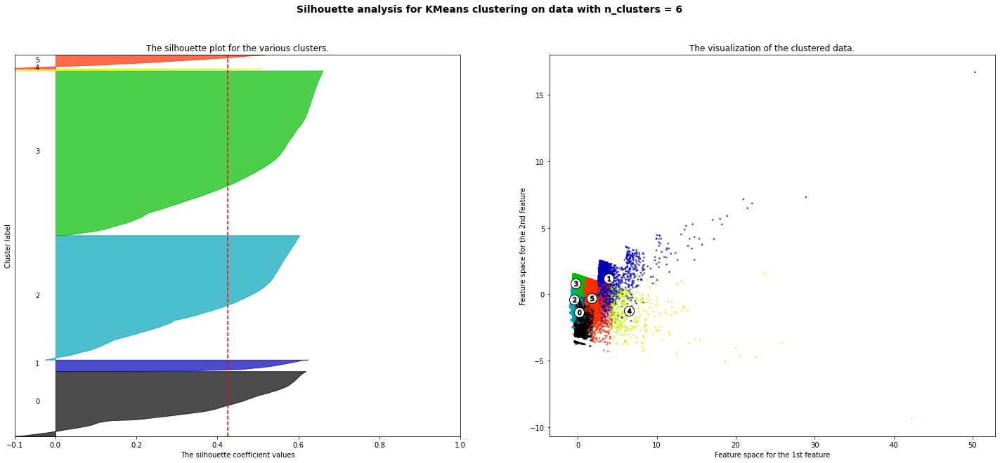

...

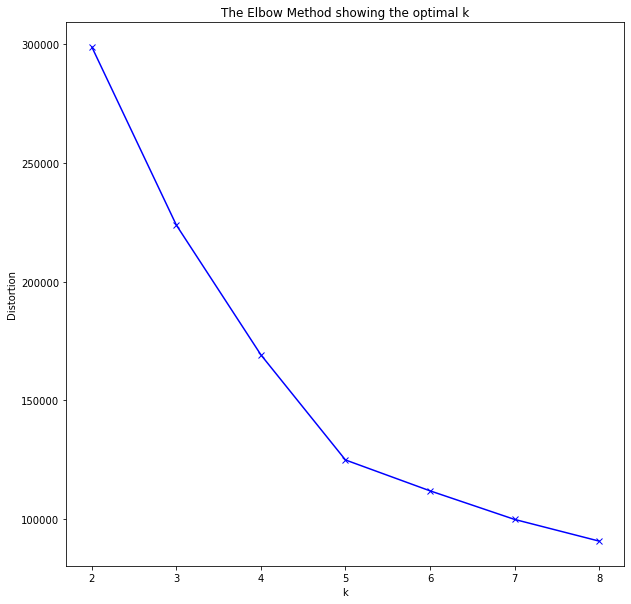

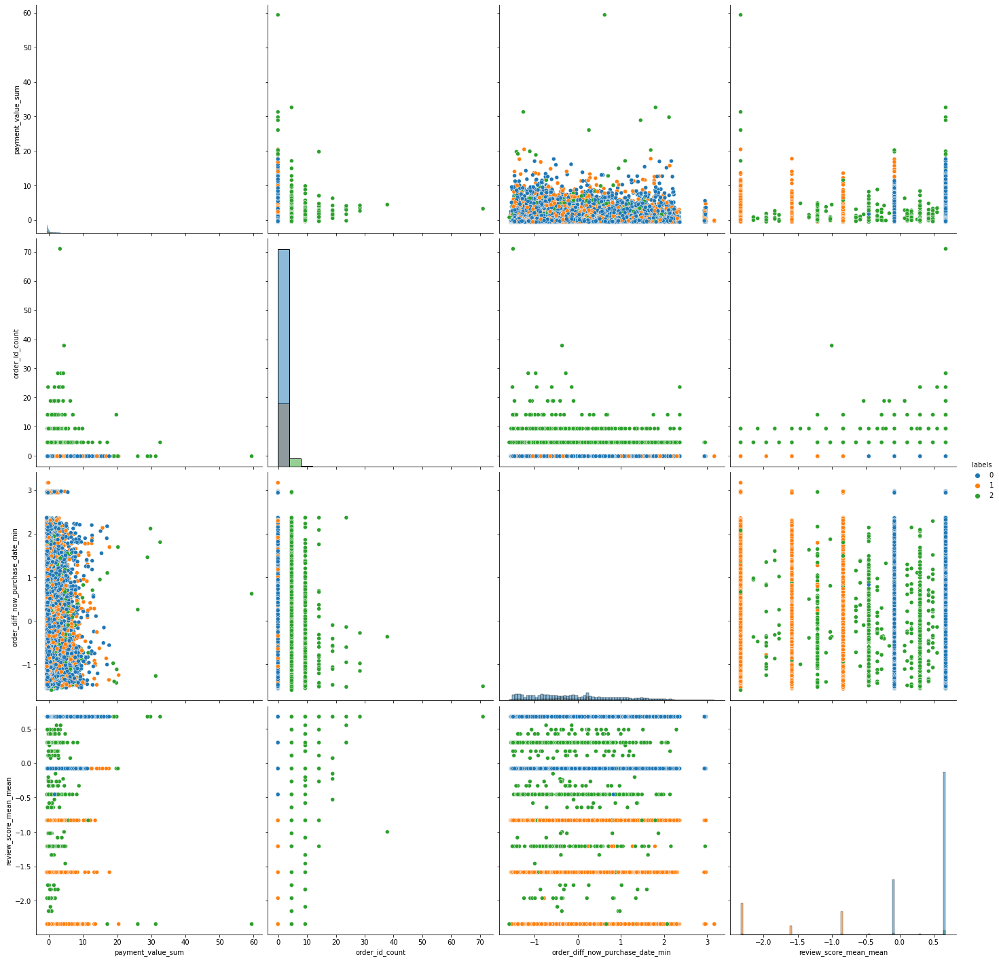

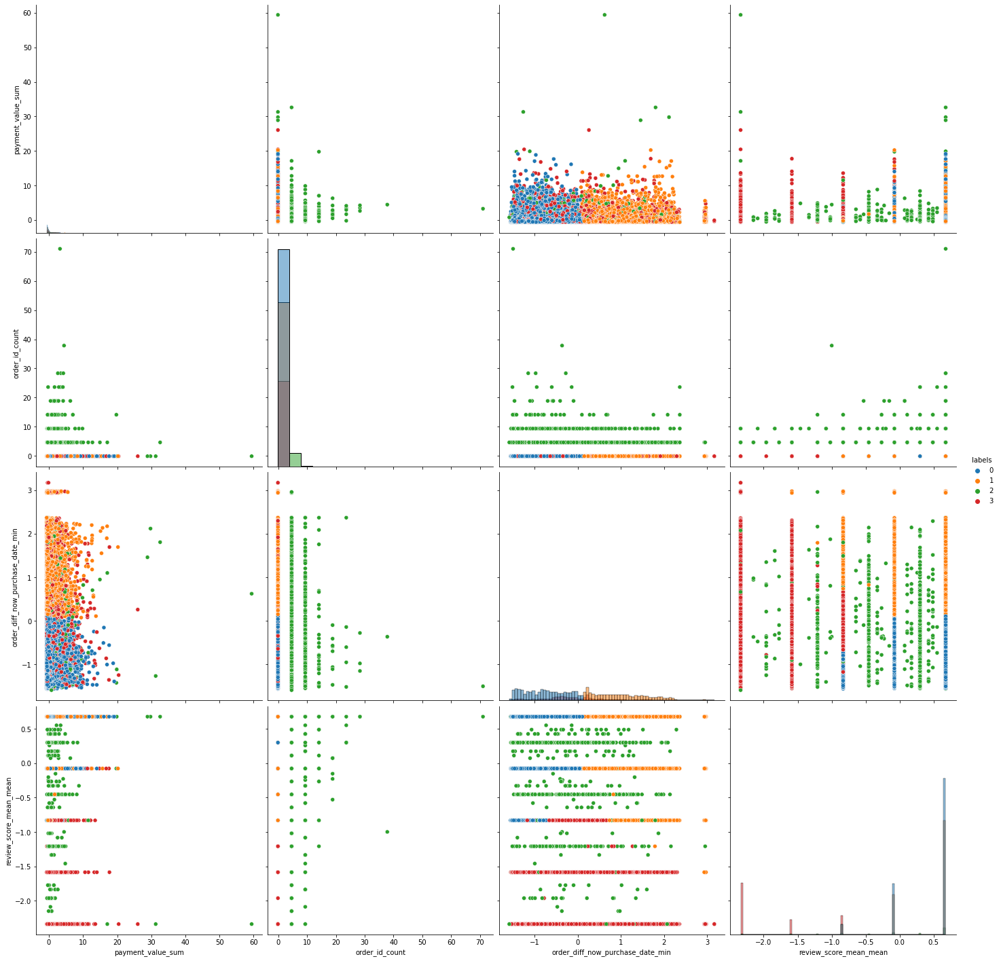

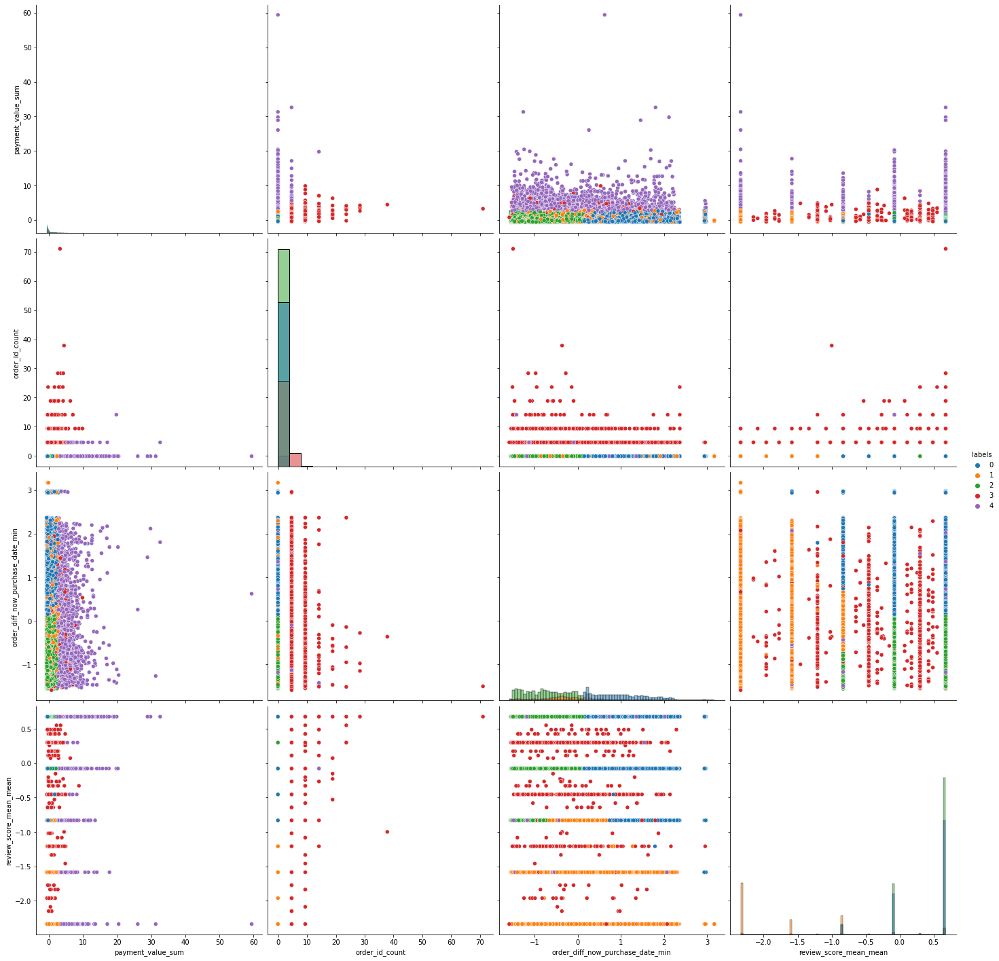

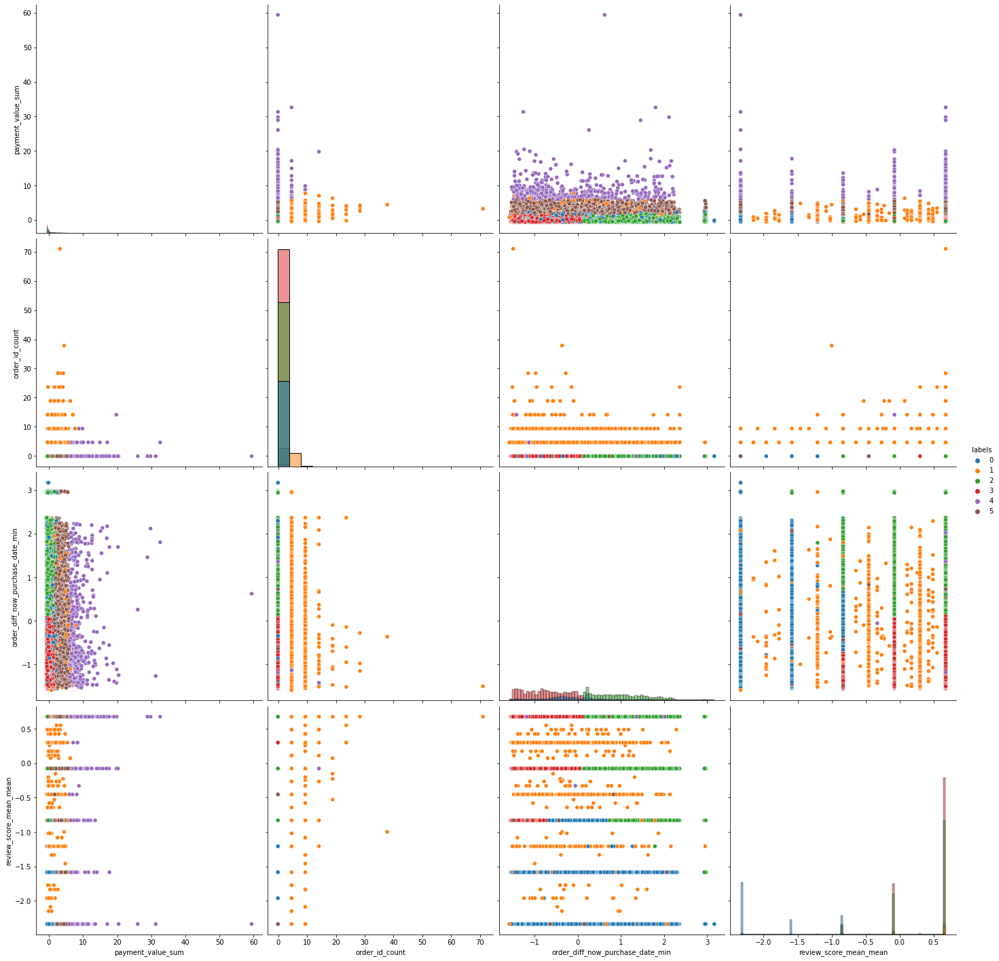

In [9]:
from src.cluster import dataHelper, kmeanHelper

columns = [
    'payment_value_sum',
    'order_id_count',
    'order_diff_now_purchase_date_min',
    'review_score_mean_mean'
]

data_helper = dataHelper(df=df[columns], limit=limit)
kmean_helper = kmeanHelper(data=data_helper)
kmean_helper.make_clusters(nx=range(2, 9))
kmean_helper.plot_results(nx=range(2, 9))
kmean_helper.plot_elbow()
kmean_helper.plot_relationship(n=3)
kmean_helper.plot_relationship(n=4)
kmean_helper.plot_relationship(n=5)
kmean_helper.plot_relationship(n=6)

#### Kmean avec 7 variables
* order_id_count
* order_status_delivered
* order_status_canceled
* order_diff_now_purchase_date_min
* product_weight_g_mean_mean
* review_score_mean_mean
* payment_value_sum

For 2 clusters, The average silhouette_score is : 0.6702197629879906
For 3 clusters, The average silhouette_score is : 0.6780243014471434
For 4 clusters, The average silhouette_score is : 0.5022449055450192
For 5 clusters, The average silhouette_score is : 0.38464941294098975
For 6 clusters, The average silhouette_score is : 0.3480690802049875
For 7 clusters, The average silhouette_score is : 0.3600894427723837
For 8 clusters, The average silhouette_score is : 0.37595503887719295
For n_clusters = 2 The average distortion is : 530584.4683890201
For n_clusters = 3 The average distortion is : 429237.1743668553
For n_clusters = 4 The average distortion is : 352267.25237517117
For n_clusters = 5 The average distortion is : 284308.78290490387
For n_clusters = 6 The average distortion is : 233253.74375501537
For n_clusters = 7 The average distortion is : 204454.69057207654
For n_clusters = 8 The average distortion is : 184257.95391969316


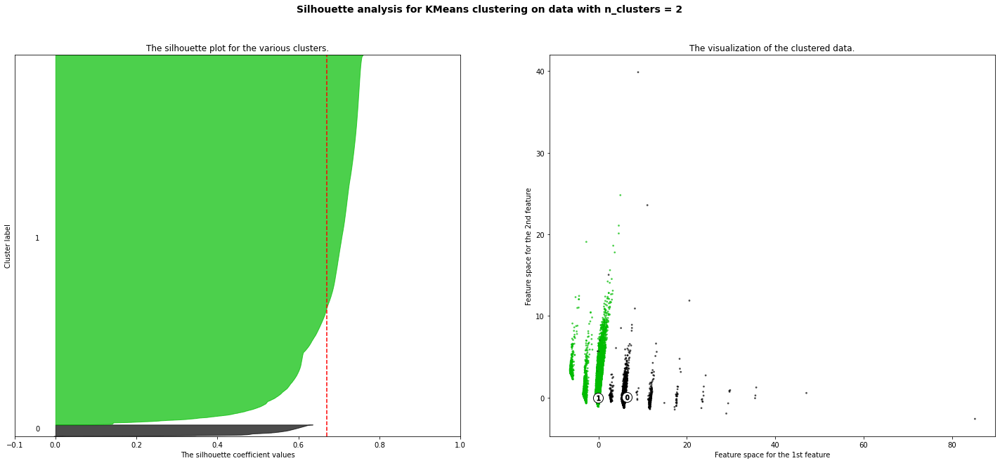

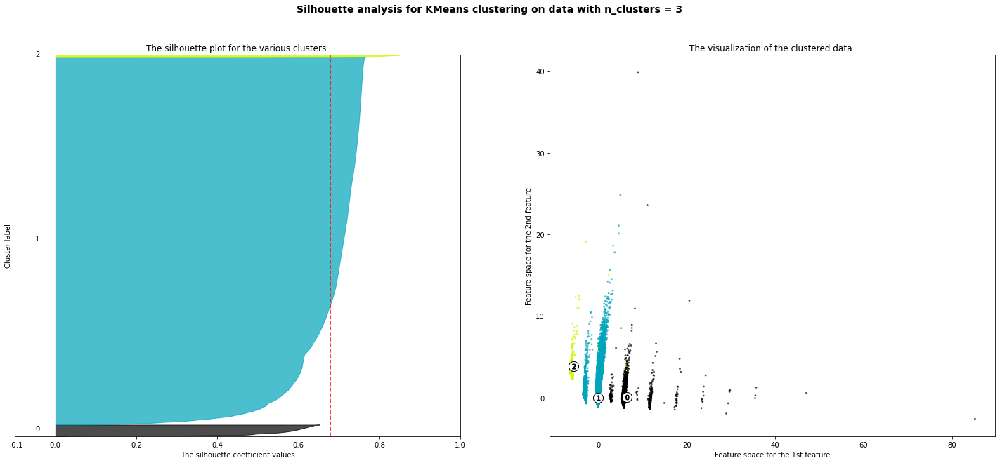

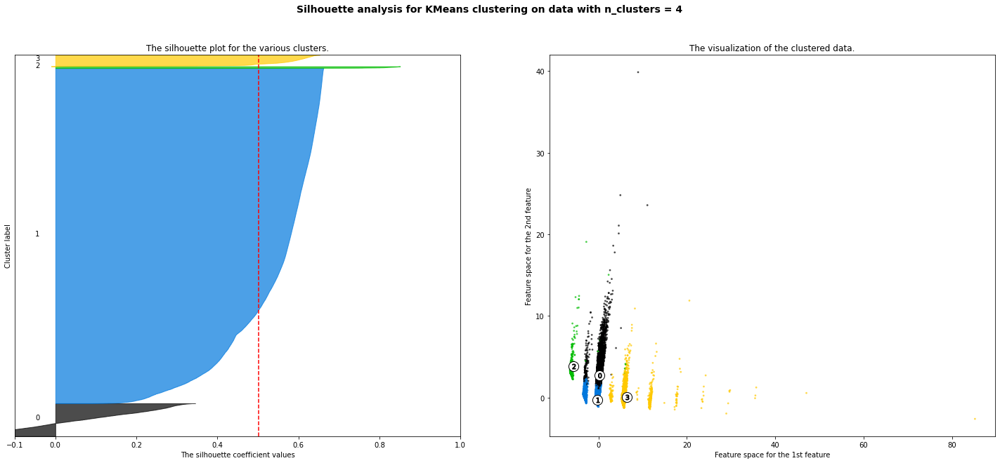

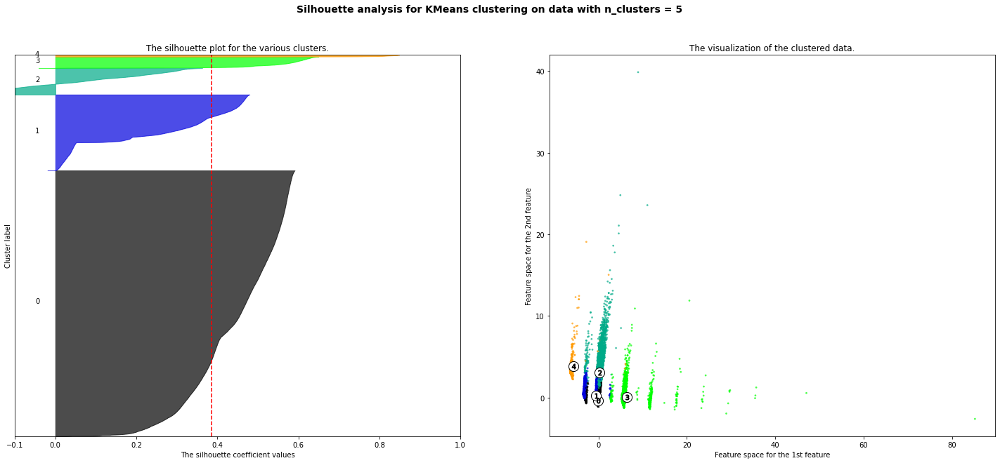

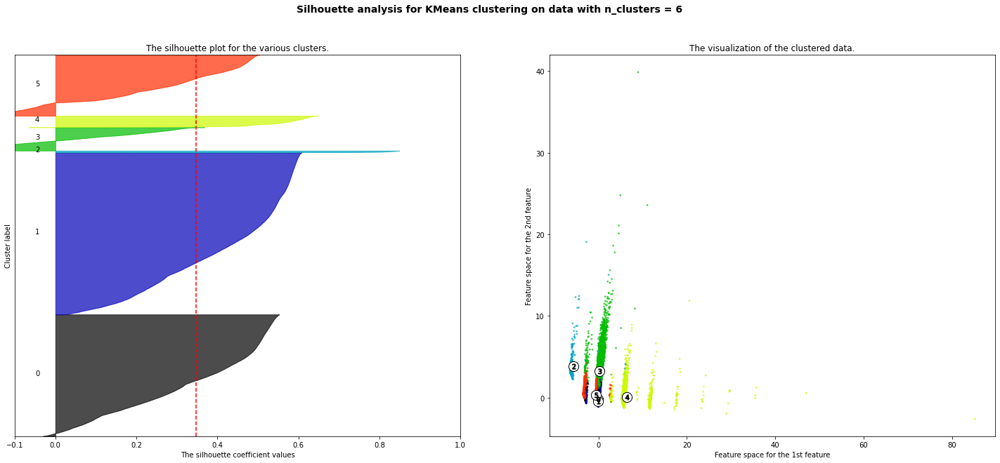

...

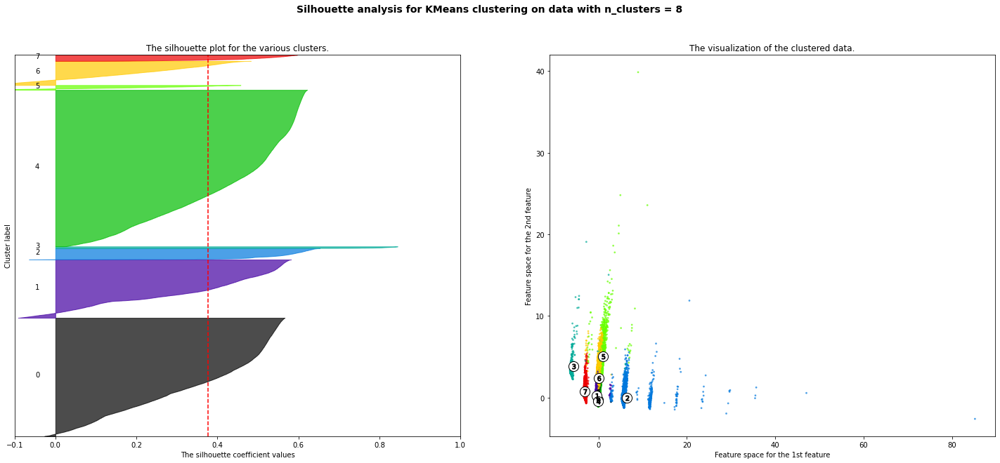

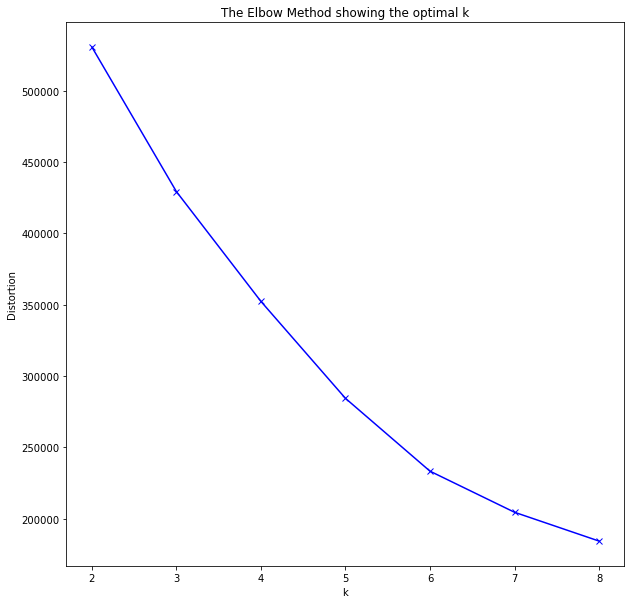

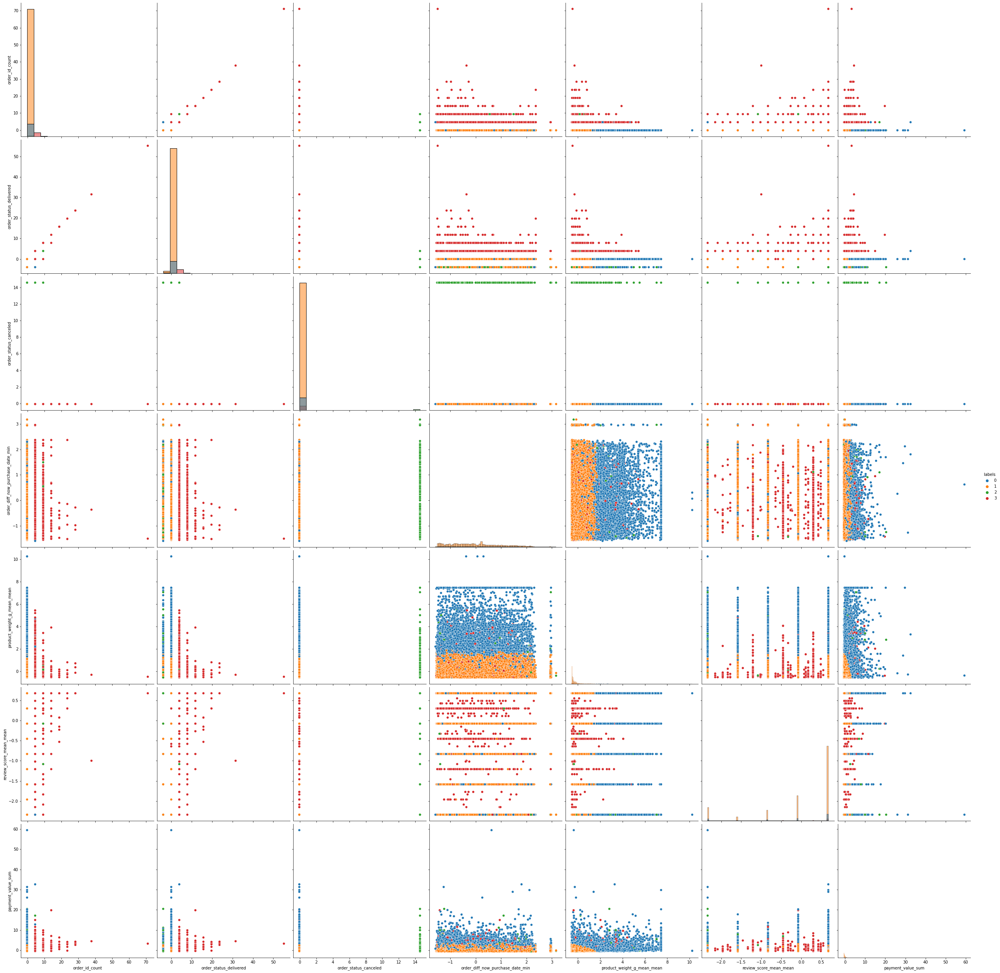

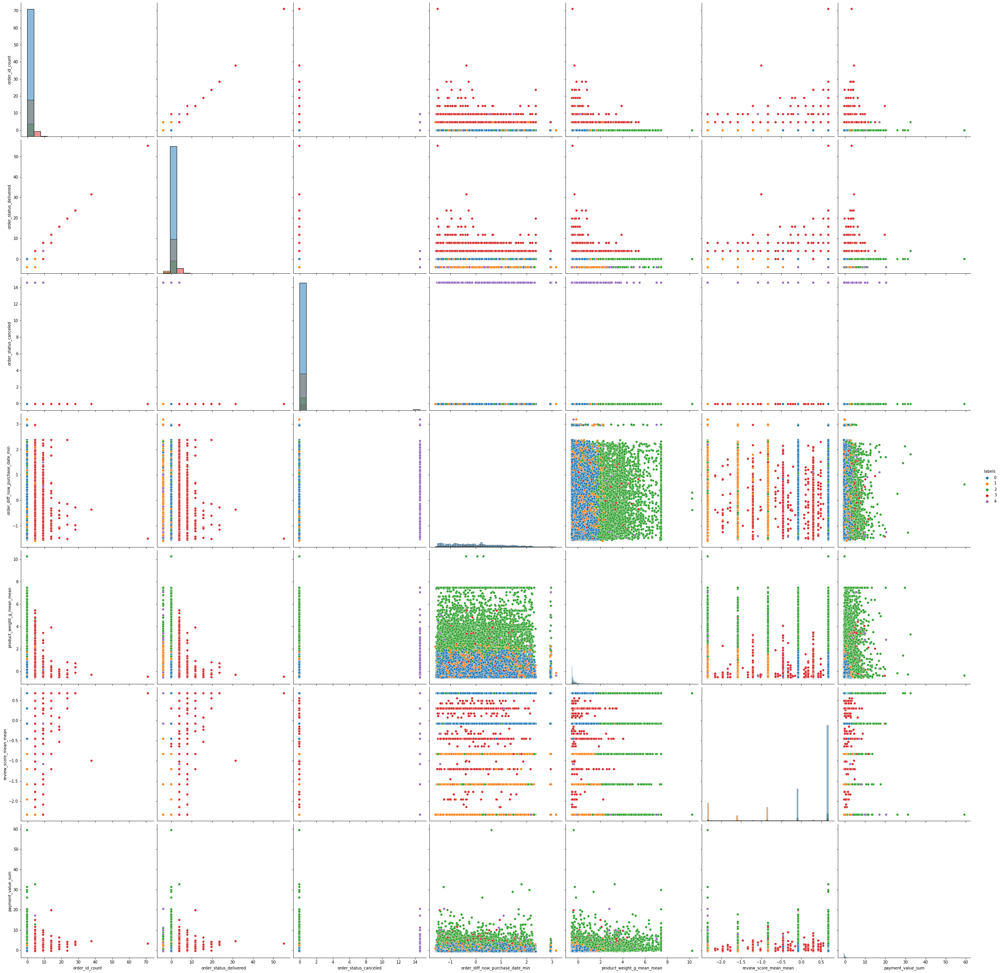

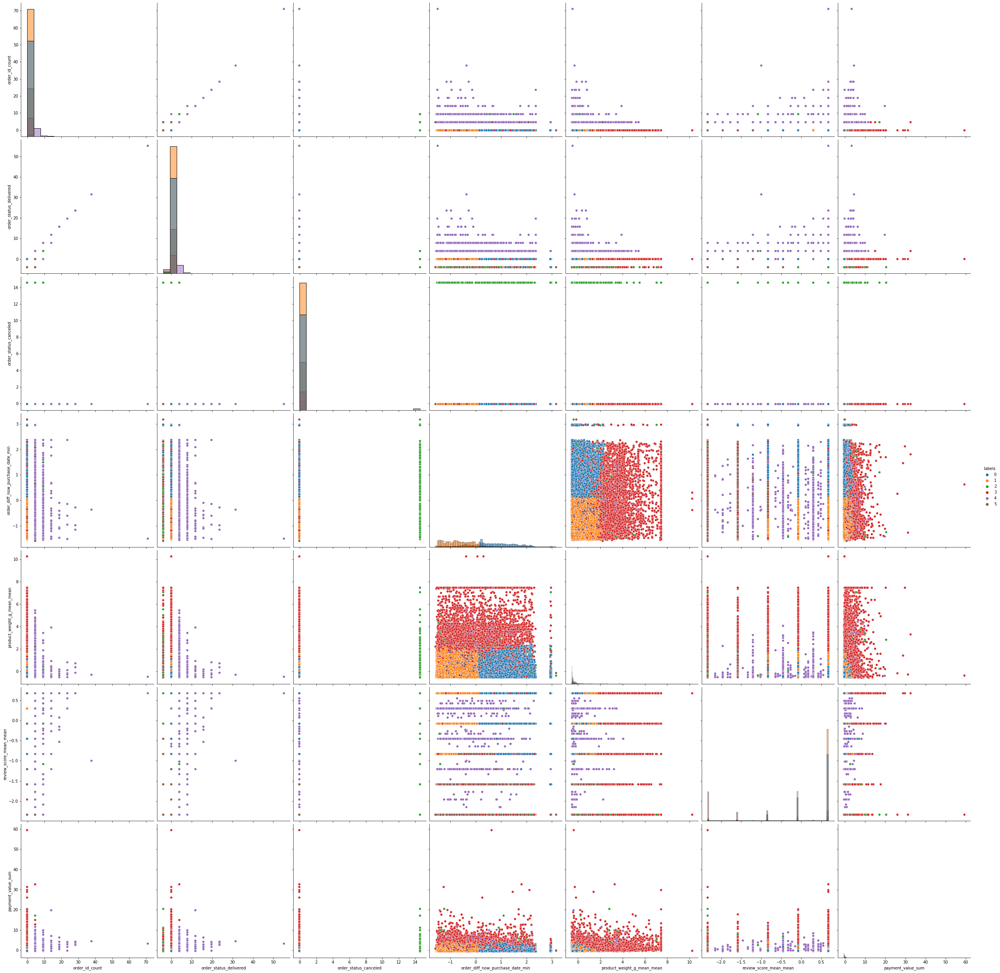

In [23]:
from src.cluster import dataHelper, kmeanHelper

columns = [
    'order_id_count',
    'order_status_delivered',
    'order_status_canceled',
    'order_diff_now_purchase_date_min',
    'product_weight_g_mean_mean',
    'review_score_mean_mean',
    'payment_value_sum'
]

data_helper = dataHelper(df=df[columns], limit=limit)
kmean_helper = kmeanHelper(data=data_helper)
kmean_helper.make_clusters(nx=range(2, 9))
kmean_helper.plot_results(nx=range(2, 9))
kmean_helper.plot_elbow()
kmean_helper.plot_relationship(n=4)
kmean_helper.plot_relationship(n=5)
kmean_helper.plot_relationship(n=6)

#### Kmean avec 6 variables
* order_id_count
* order_status_delivered
* order_status_canceled
* review_score_mean_mean
* payment_boleto_sum
* payment_value_sum

For 2 clusters, The average silhouette_score is : 0.7268818790449892
For 3 clusters, The average silhouette_score is : 0.7356252799366061
For 4 clusters, The average silhouette_score is : 0.5299907783571505
For 5 clusters, The average silhouette_score is : 0.5814759030805489
For 6 clusters, The average silhouette_score is : 0.6083704795693099
For 7 clusters, The average silhouette_score is : 0.6177186746362
For 8 clusters, The average silhouette_score is : 0.6304153899223874
For n_clusters = 2 The average distortion is : 435523.5254410366
For n_clusters = 3 The average distortion is : 334198.47860694455
For n_clusters = 4 The average distortion is : 250699.24341817043
For n_clusters = 5 The average distortion is : 189338.17706521746
For n_clusters = 6 The average distortion is : 146068.93474732785
For n_clusters = 7 The average distortion is : 126315.96306074834
For n_clusters = 8 The average distortion is : 109039.98144719699


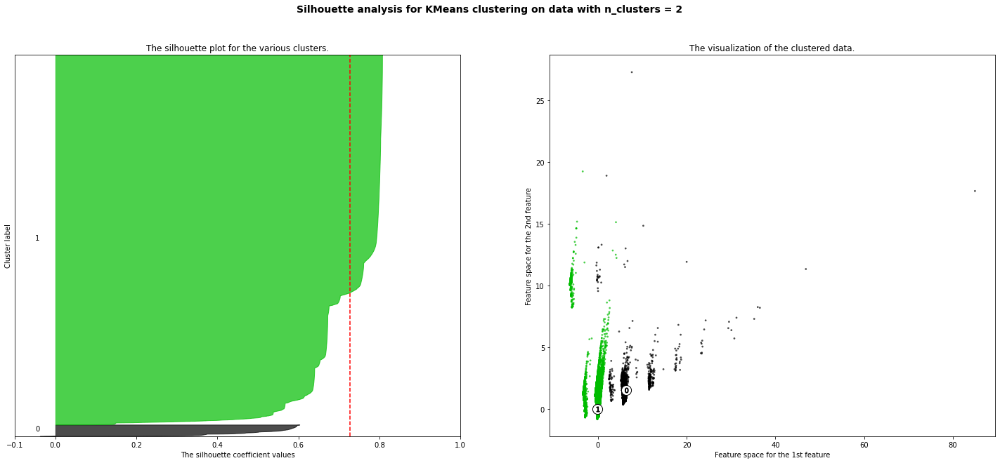

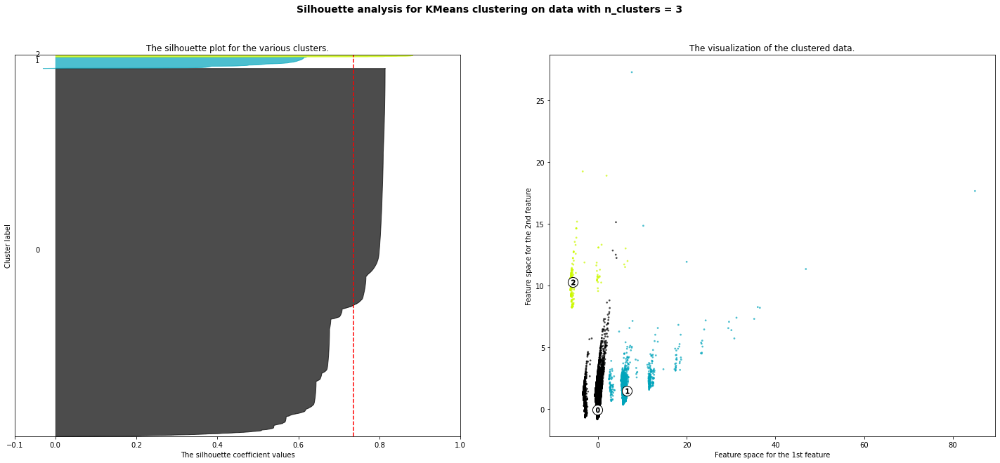

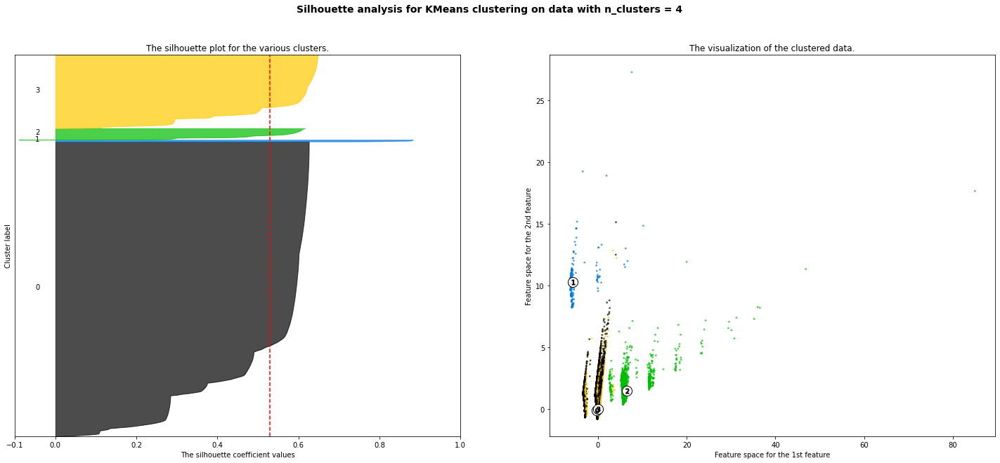

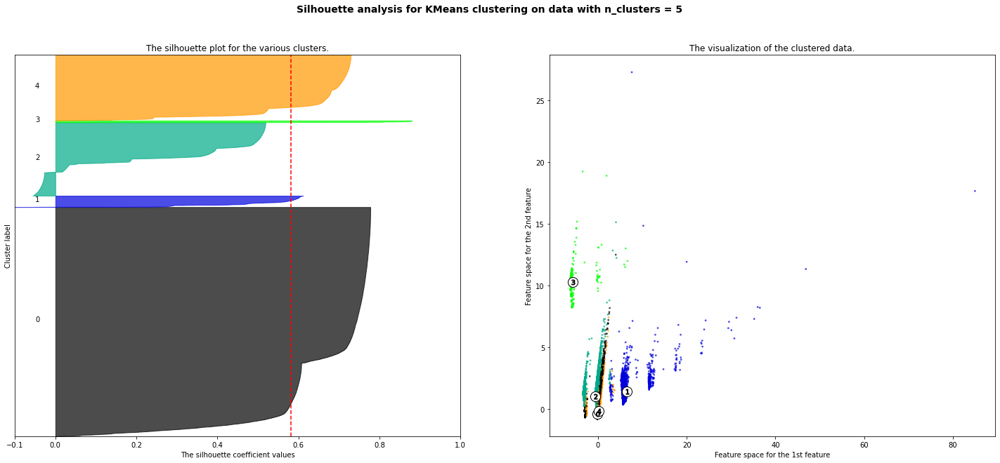

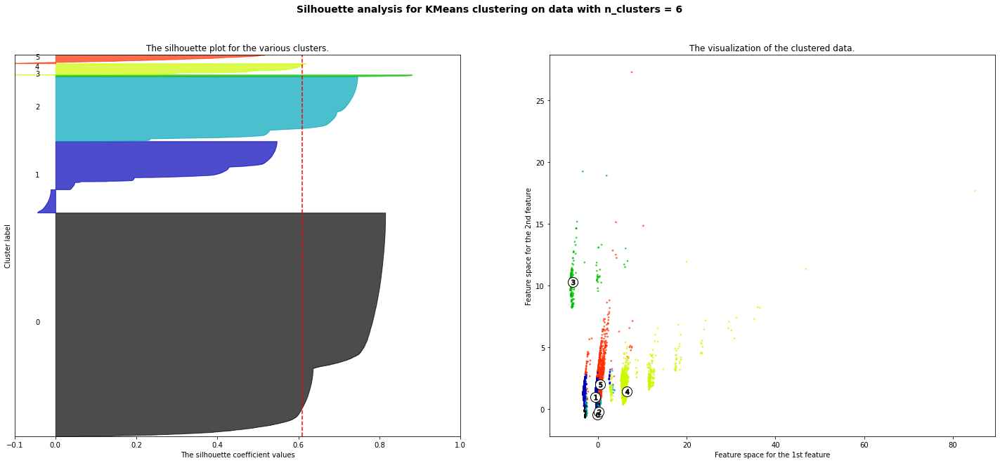

...

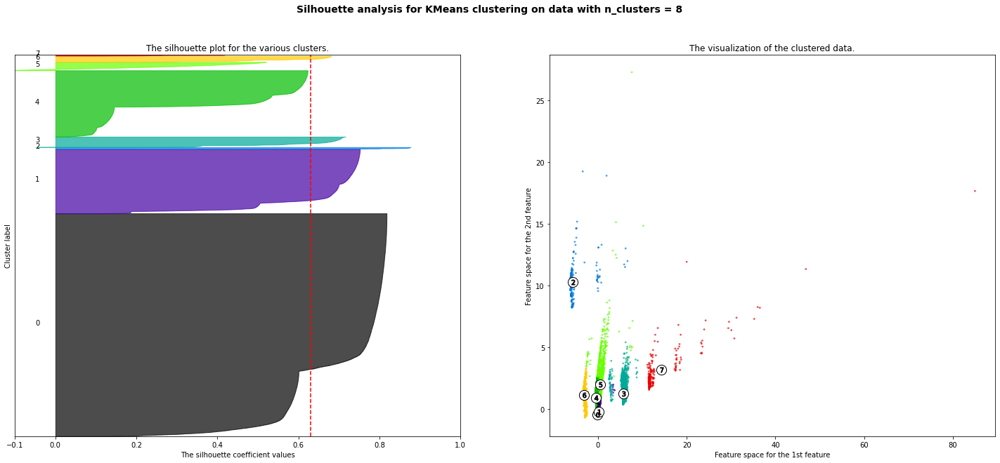

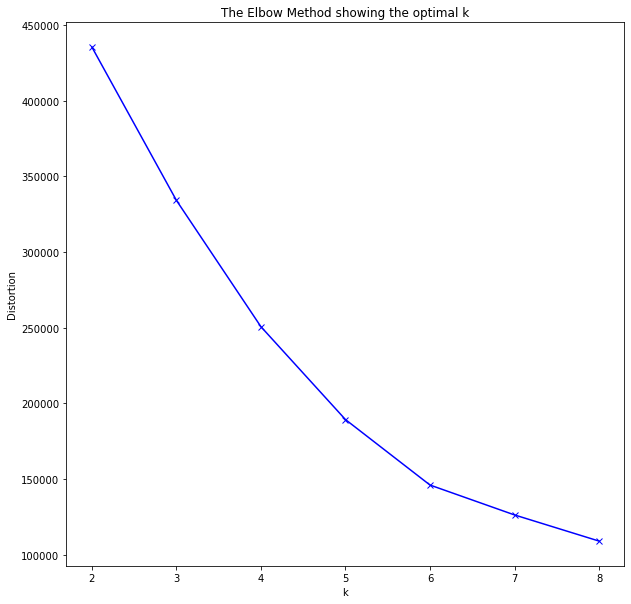

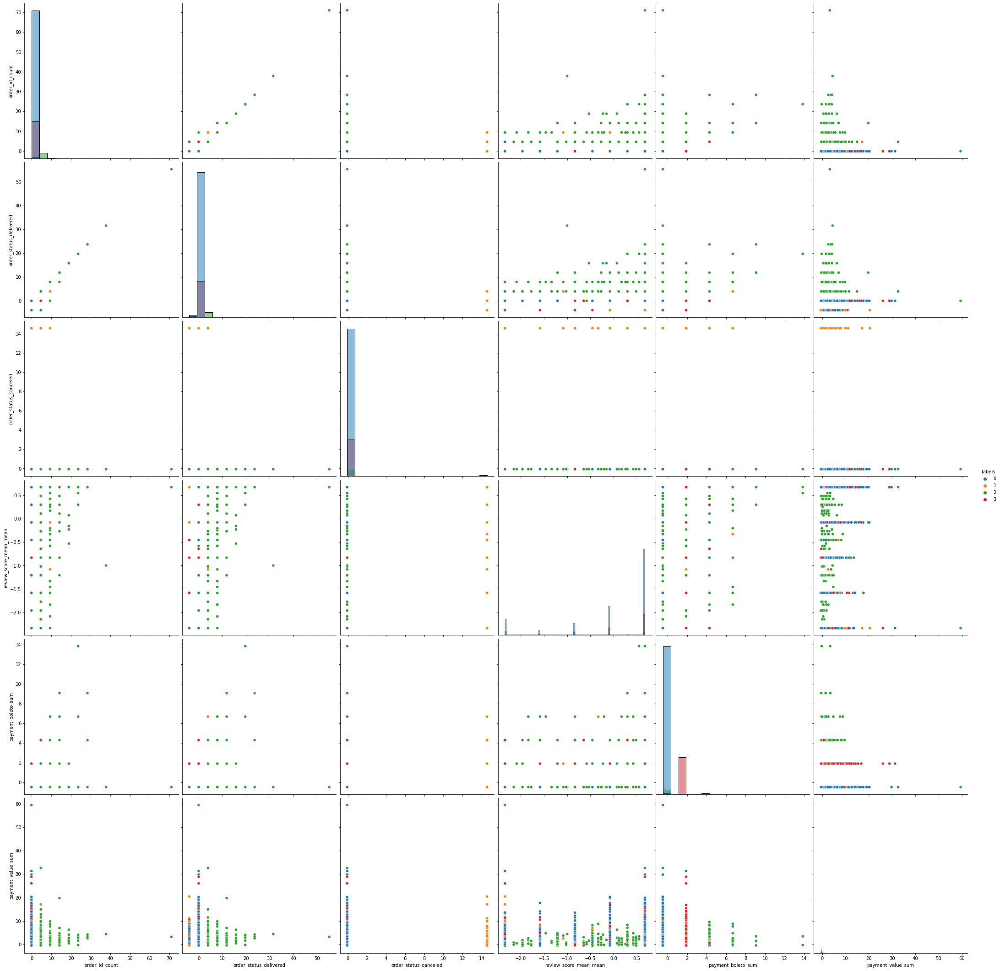

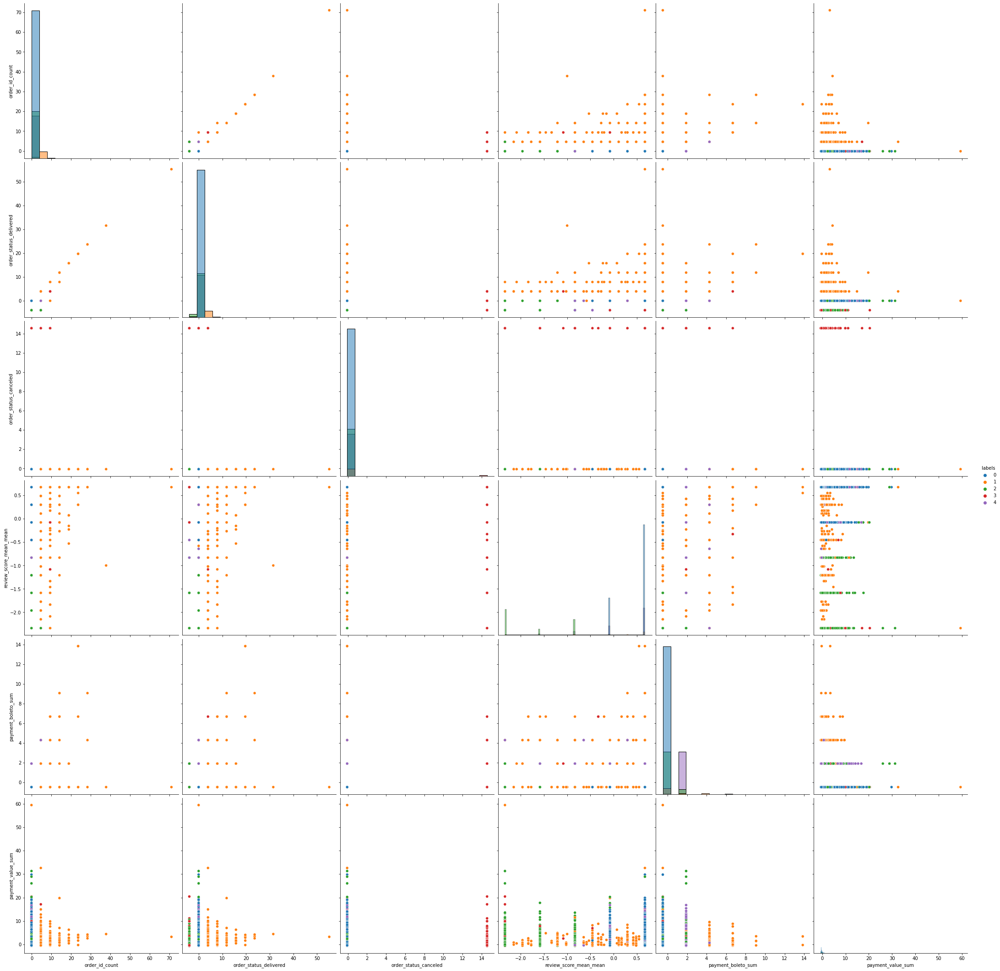

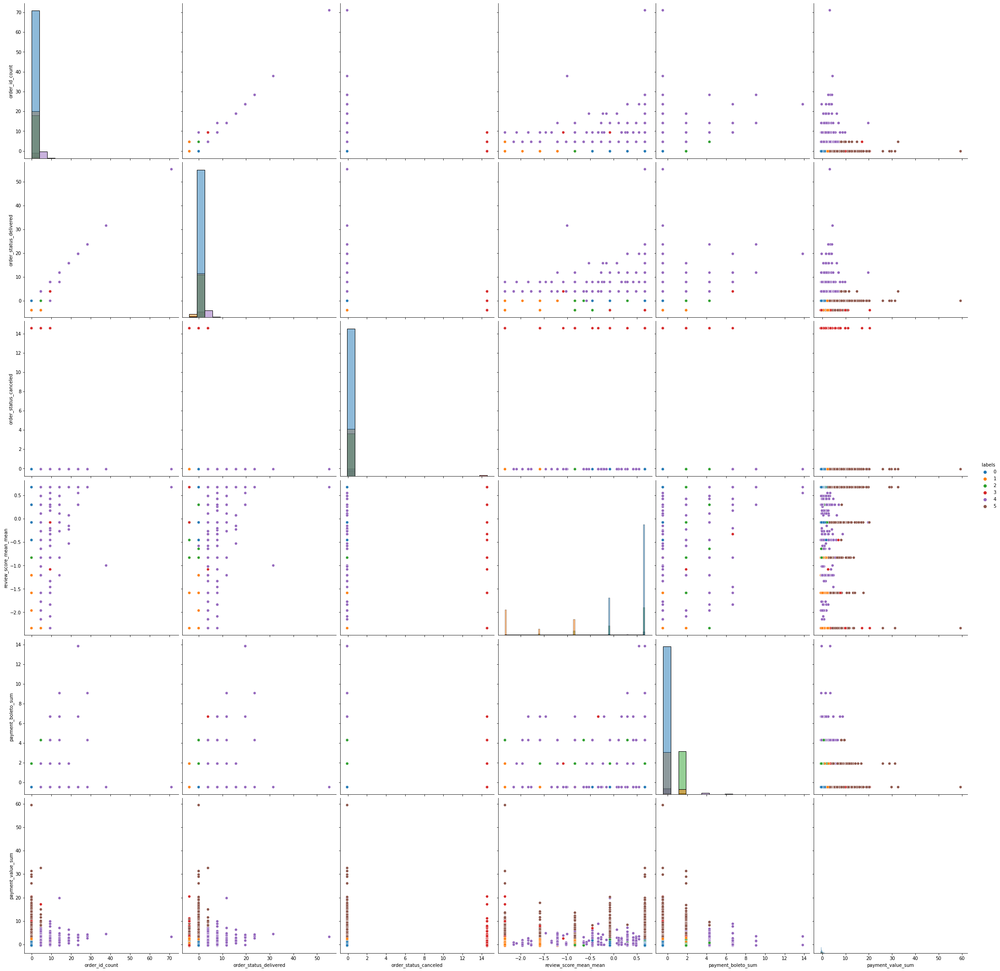

In [24]:
from src.cluster import dataHelper, kmeanHelper

columns = [
    'order_id_count',
    'order_status_delivered',
    'order_status_canceled',
    'review_score_mean_mean',
    'payment_boleto_sum',
    'payment_value_sum'
]

data_helper = dataHelper(df=df[columns], limit=limit)
kmean_helper = kmeanHelper(data=data_helper)
kmean_helper.make_clusters(nx=range(2, 9))
kmean_helper.plot_results(nx=range(2, 9))
kmean_helper.plot_elbow()
kmean_helper.plot_relationship(n=4)
kmean_helper.plot_relationship(n=5)
kmean_helper.plot_relationship(n=6)

#### Kmean avec 9 variables
* order_id_count
* order_status_delivered
* order_status_canceled
* order_diff_now_purchase_date_min
* product_weight_g_mean_mean
* review_score_mean_mean
* payment_debit_sum
* payment_boleto_sum
* payment_value_sum

For n_clusters = 2 The average distortion is : 718832.9782507853
For n_clusters = 3 The average distortion is : 617493.5630400075
For n_clusters = 4 The average distortion is : 540486.7069031522
For n_clusters = 5 The average distortion is : 450110.11819095357
For n_clusters = 6 The average distortion is : 383159.23668814497
For n_clusters = 7 The average distortion is : 333035.67733088636
For n_clusters = 8 The average distortion is : 275988.810396736


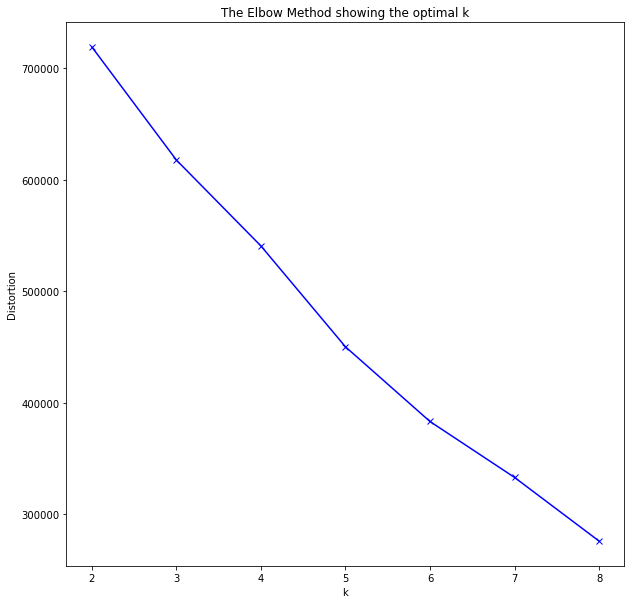

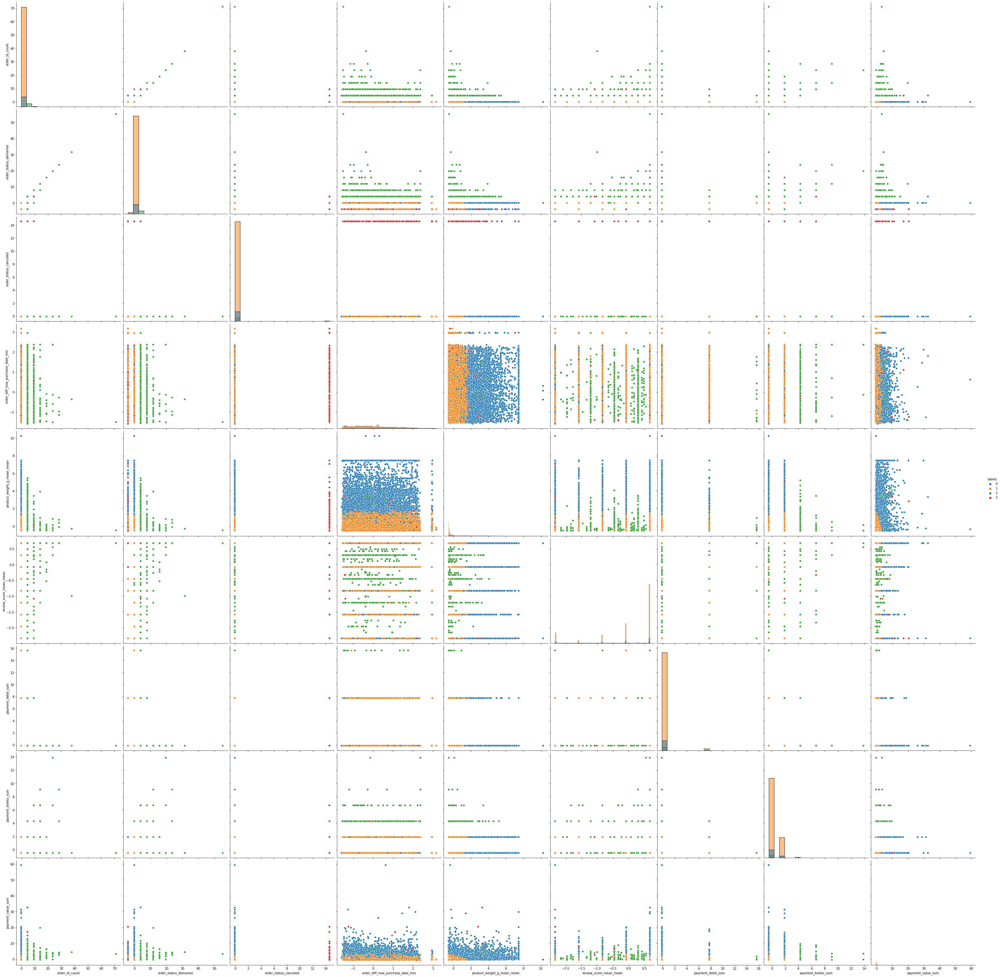

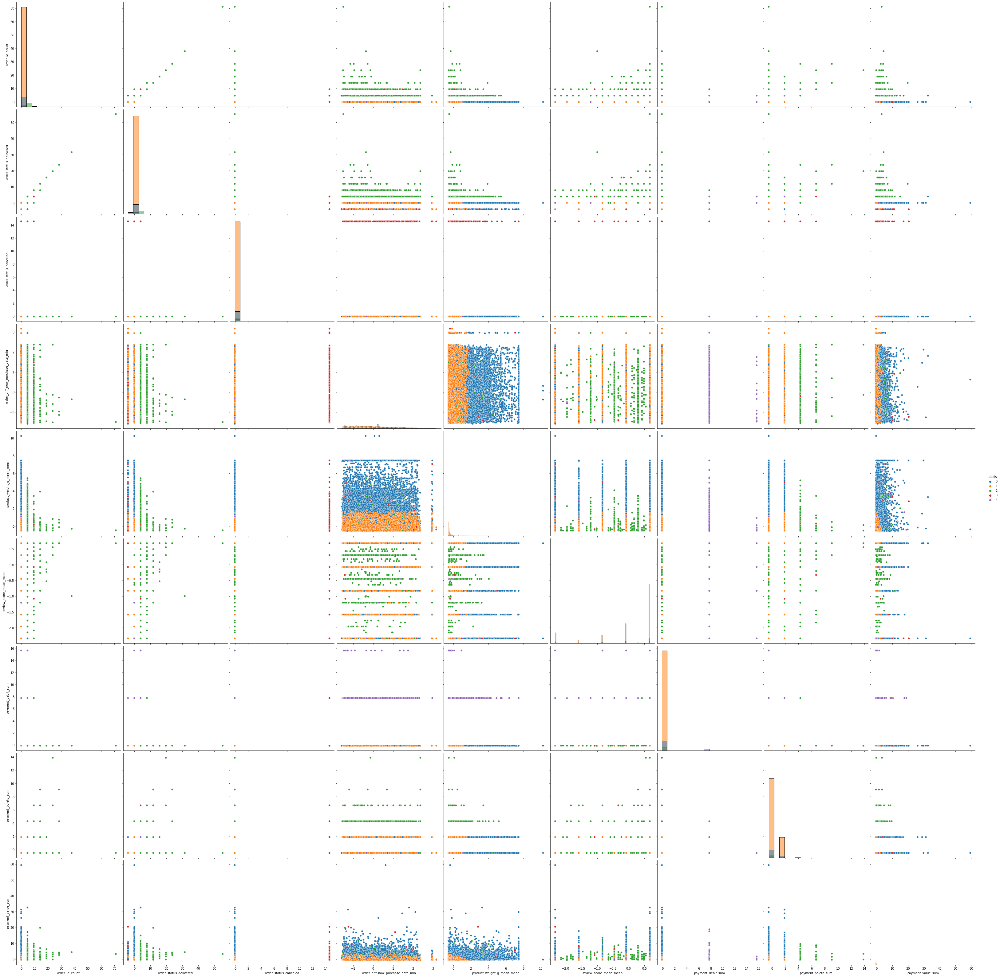

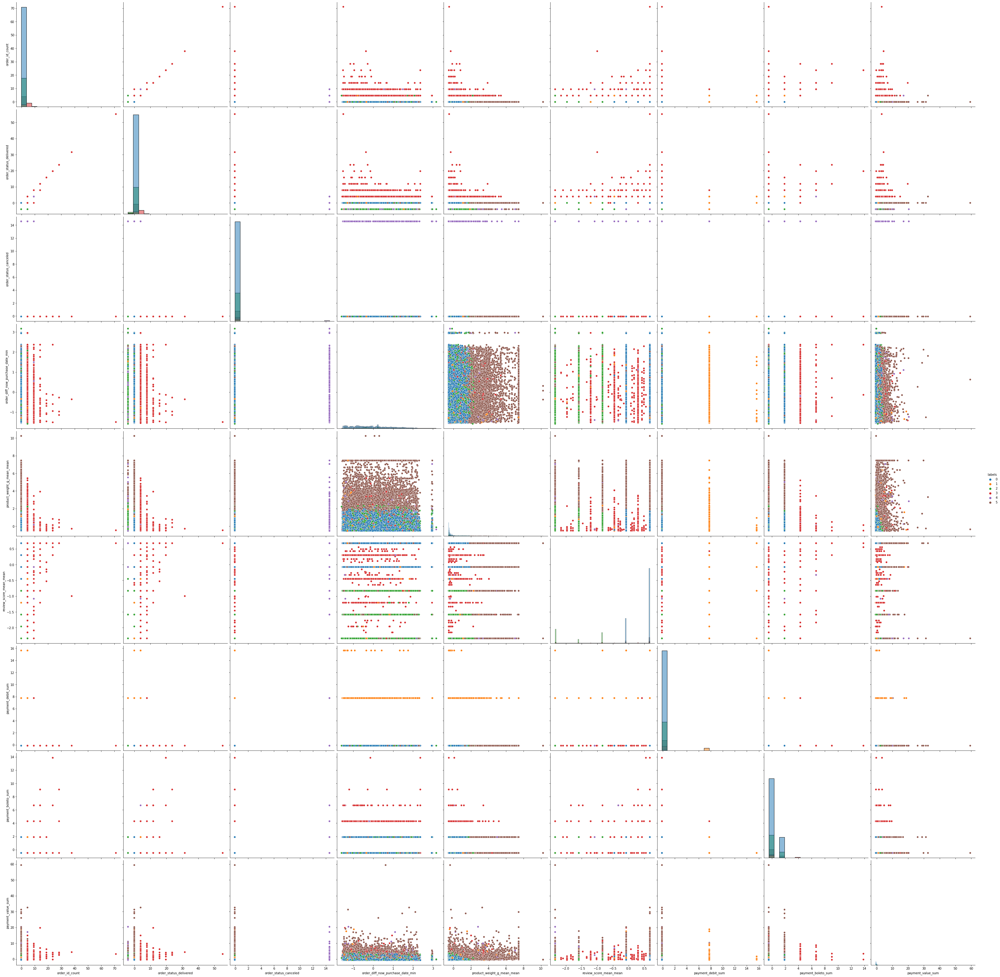

In [25]:
from src.cluster import dataHelper, kmeanHelper

columns = [
    'order_id_count',
    'order_status_delivered',
    'order_status_canceled',
    'order_diff_now_purchase_date_min',
    'product_weight_g_mean_mean',
    'review_score_mean_mean',
    'payment_debit_sum',
    'payment_boleto_sum',
    'payment_value_sum'
]

data_helper = dataHelper(df=df[columns], limit=limit)
kmean_helper = kmeanHelper(data=data_helper)
kmean_helper.make_clusters(nx=range(2, 9))
kmean_helper.plot_results(nx=range(2, 0))
kmean_helper.plot_elbow()
kmean_helper.plot_relationship(n=4)
kmean_helper.plot_relationship(n=5)
kmean_helper.plot_relationship(n=6)

### DBSCAN

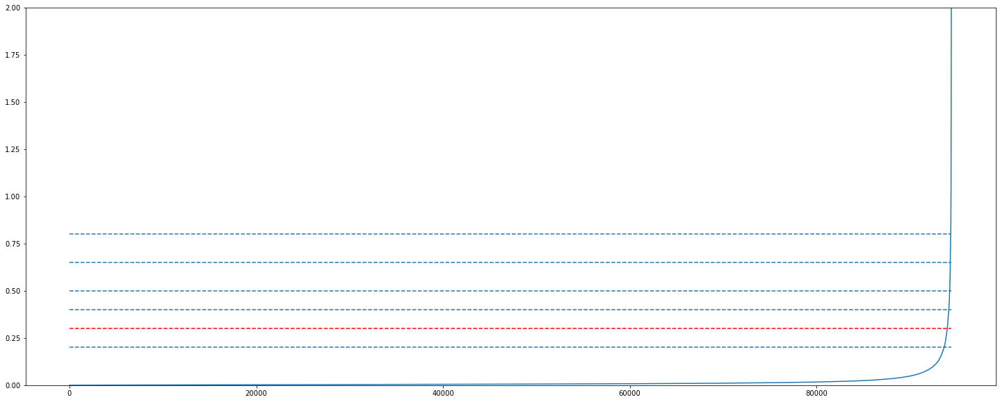

In [10]:
from src.cluster import dataHelper, kmeanHelper
from sklearn.neighbors import NearestNeighbors # importing the library

columns = [
    'payment_value_sum',
    'order_id_count',
    'order_diff_now_purchase_date_min',
    'review_score_mean_mean'
]

data_helper = dataHelper(df=df[columns], limit=limit)

neighb = NearestNeighbors(n_neighbors=2) # creating an object of the NearestNeighbors class
nbrs=neighb.fit(data_helper.get_data_scaled()) # fitting the data to the object
distances,indices=nbrs.kneighbors(data_helper.get_data_scaled()) # finding the nearest neighbours

# Sort and plot the distances results
distances = np.sort(distances, axis = 0) # sorting the distances
distances = distances[:, 1] # taking the second column of the sorted distances
fig = plt.figure(figsize=(25, 10))
plt.rcParams['figure.figsize'] = (5,3) # setting the figure size
plt.plot(distances) # plotting the distances
plt.ylim(0, 2)
plt.hlines(y=0.2, xmin=0, xmax=len(distances), linestyles='dashed') # plotting the threshold
plt.hlines(y=0.3, xmin=0, xmax=len(distances), linestyles='dashed', colors=['red']) # plotting the threshold
plt.hlines(y=0.4, xmin=0, xmax=len(distances), linestyles='dashed') # plotting the threshold
plt.hlines(y=0.5, xmin=0, xmax=len(distances), linestyles='dashed') # plotting the threshold
plt.hlines(y=0.65, xmin=0, xmax=len(distances), linestyles='dashed') # plotting the threshold
plt.hlines(y=0.8, xmin=0, xmax=len(distances), linestyles='dashed') # plotting the threshold
plt.show() # showing the plot

Making clusters: dbscan (0.3,5)
For dbscan (0.3,5) clusters, Estimated number of clusters: 49
For dbscan (0.3,5) clusters, Estimated number of noise points: 951
Making clusters: dbscan (0.3,10)
For dbscan (0.3,10) clusters, Estimated number of clusters: 25
For dbscan (0.3,10) clusters, Estimated number of noise points: 1694
Making clusters: dbscan (0.3,50)
For dbscan (0.3,50) clusters, Estimated number of clusters: 8
For dbscan (0.3,50) clusters, Estimated number of noise points: 4727
Making clusters: dbscan (0.3,100)
For dbscan (0.3,100) clusters, Estimated number of clusters: 6
For dbscan (0.3,100) clusters, Estimated number of noise points: 6721
For dbscan (0.3,5) clusters, The average silhouette_score is : 0.08031456713722887
For dbscan (0.3,10) clusters, The average silhouette_score is : 0.06884470708273194
For dbscan (0.3,50) clusters, The average silhouette_score is : 0.0905631699964718
For dbscan (0.3,100) clusters, The average silhouette_score is : 0.13141635313168676


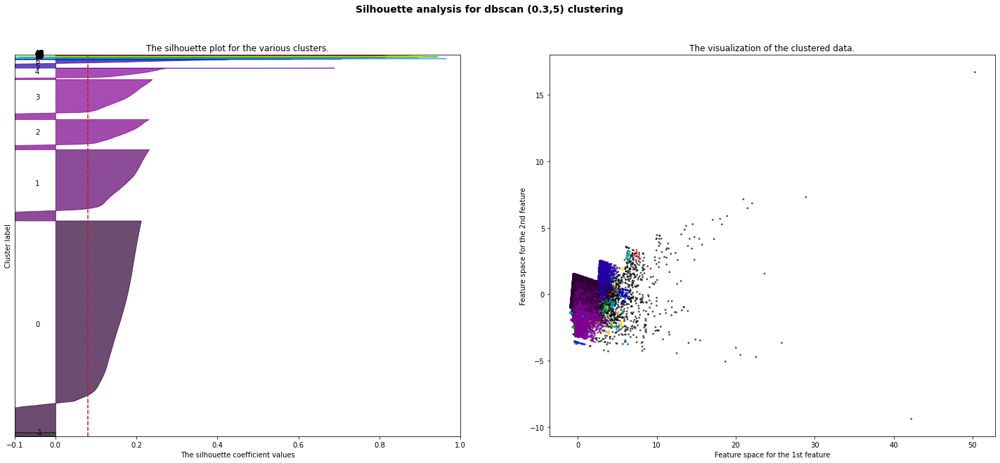

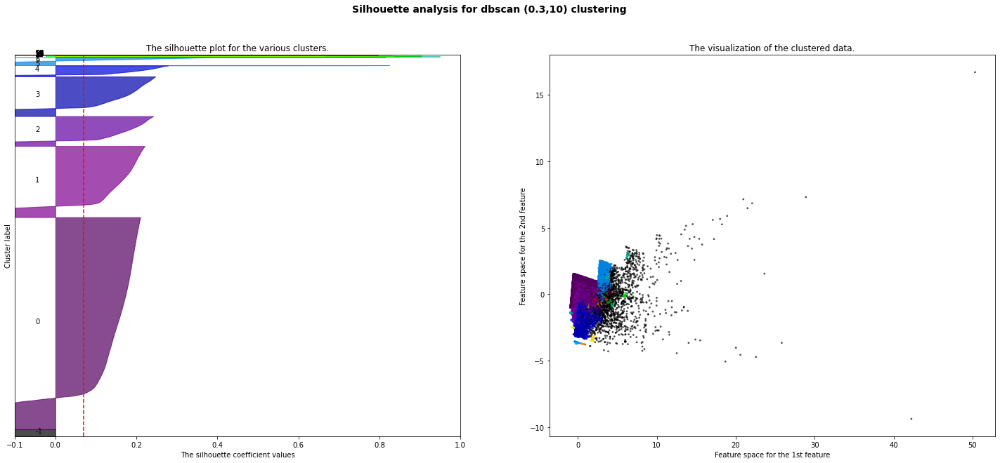

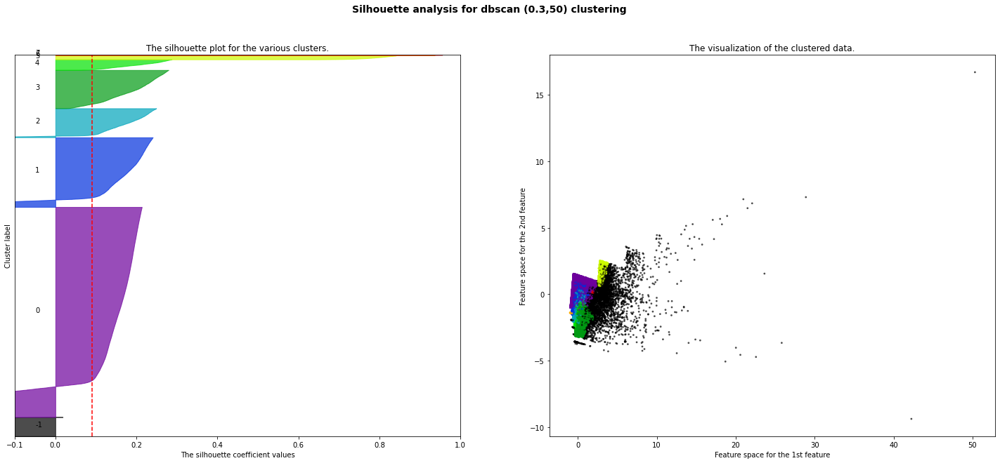

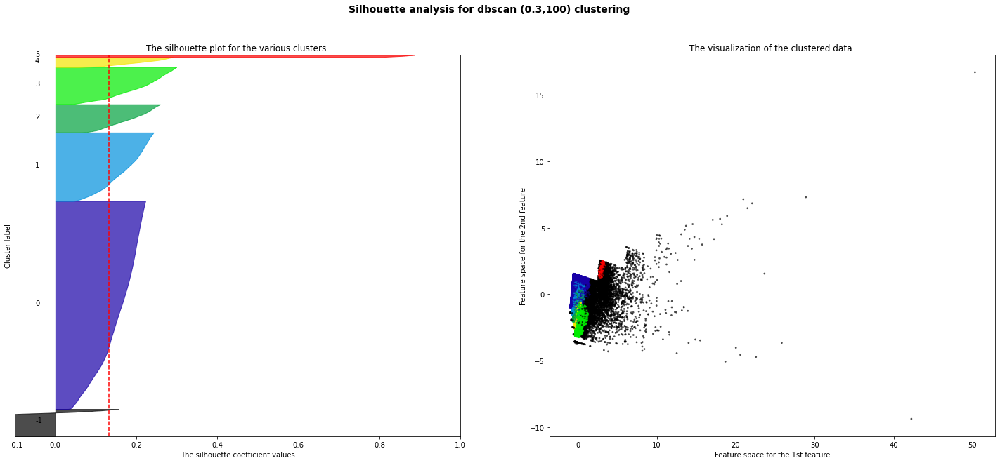

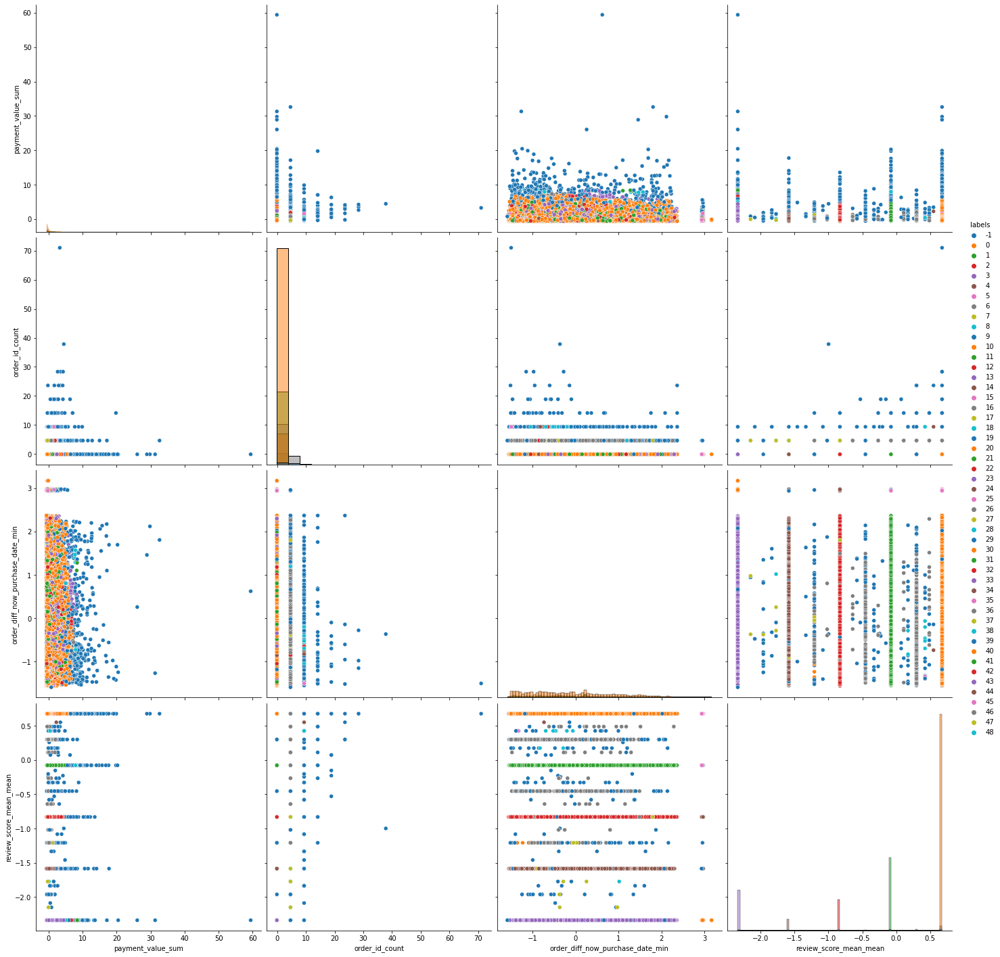

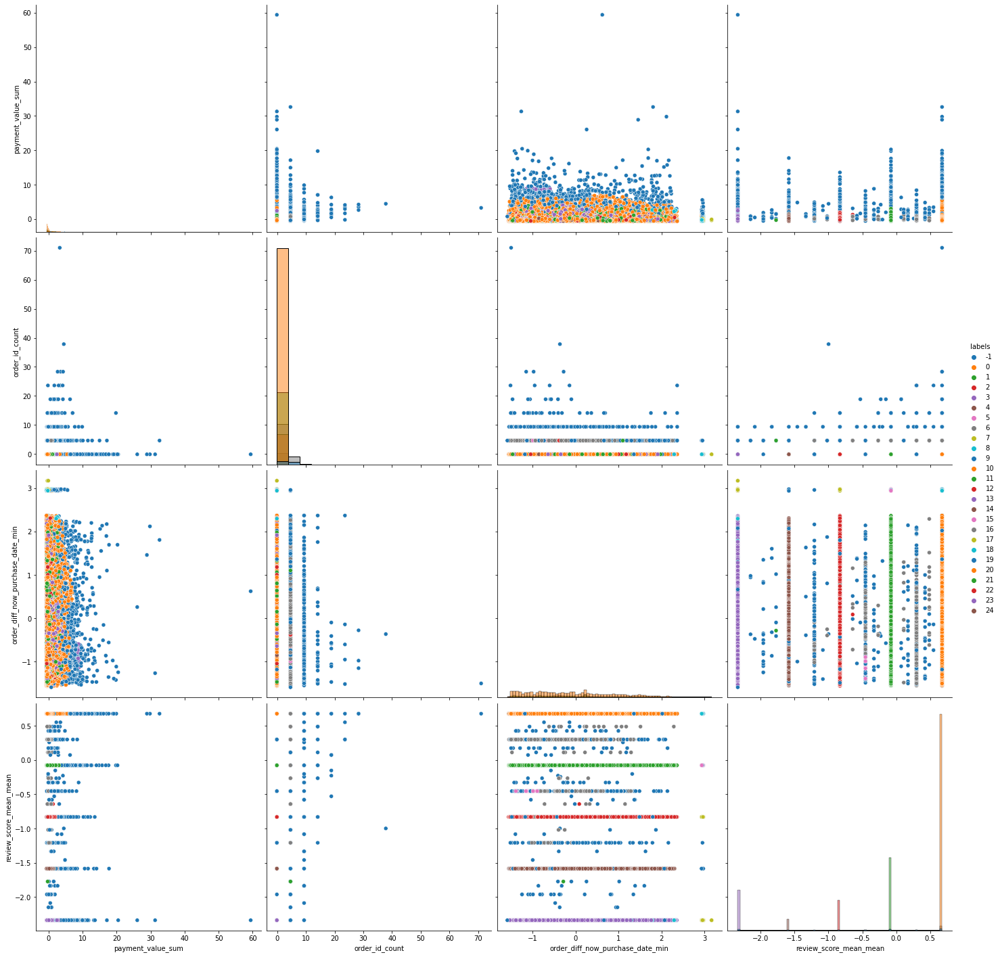

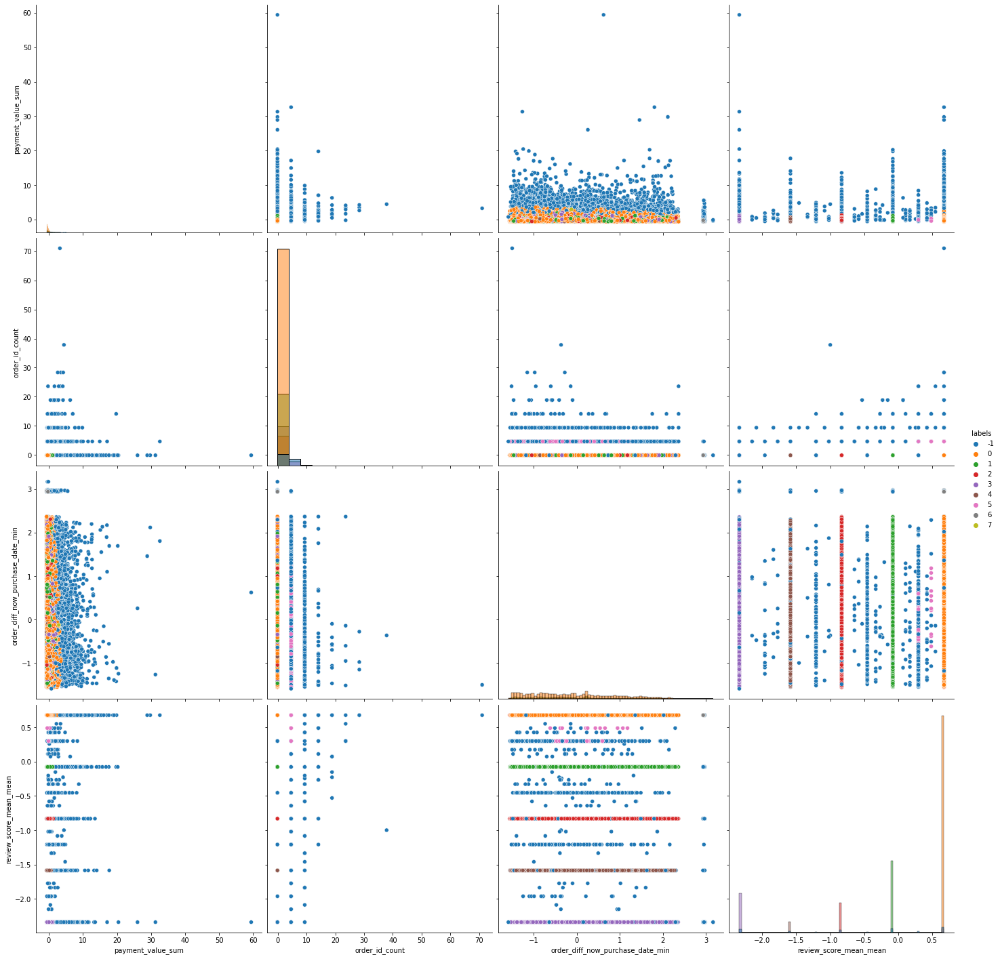

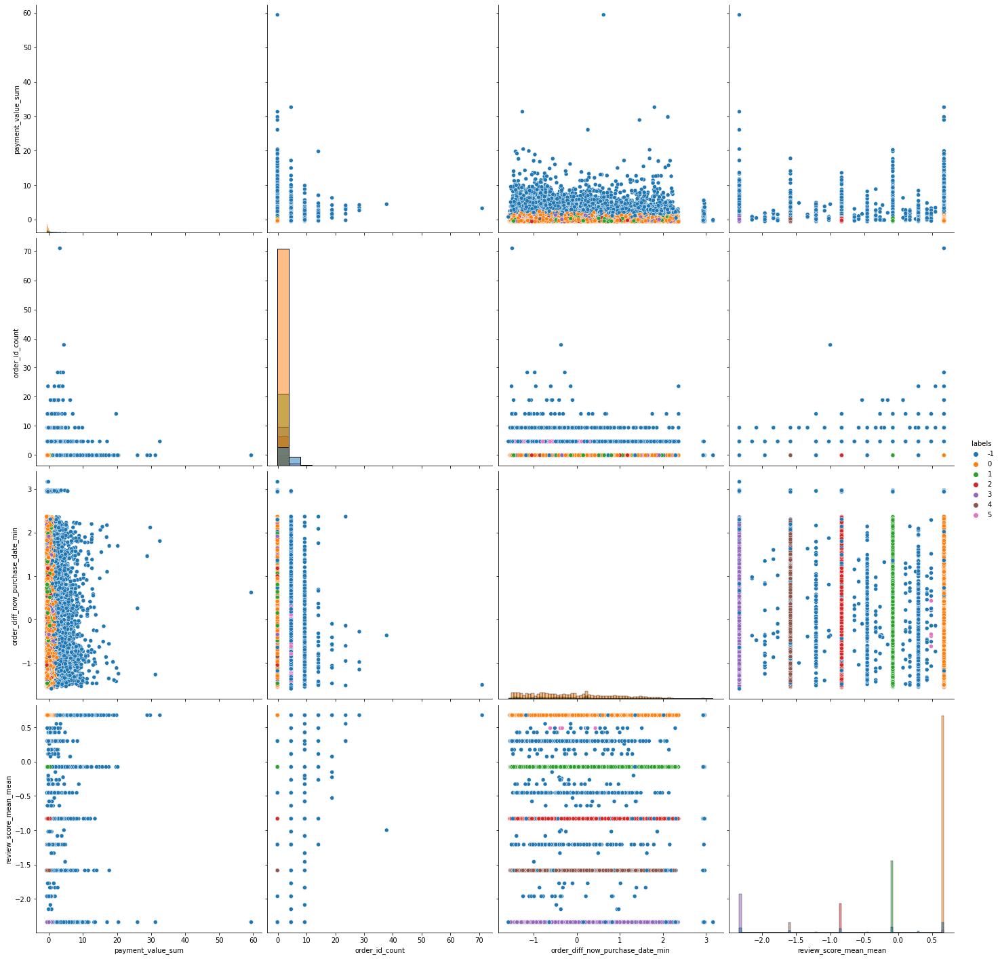

In [11]:
from src.cluster import dataHelper, dbscanHelper

columns = [
    'payment_value_sum',
    'order_id_count',
    'order_diff_now_purchase_date_min',
    'review_score_mean_mean'
]

data_helper = dataHelper(df=df[columns], limit=limit)
dbscan_helper = dbscanHelper(data=data_helper)

dbscan_helper.make_model(n='dbscan (0.3,5)', params={'eps': 0.3, 'min_samples': 5})
dbscan_helper.make_model(n='dbscan (0.3,10)', params={'eps': 0.3, 'min_samples': 10})
dbscan_helper.make_model(n='dbscan (0.3,50)', params={'eps': 0.3, 'min_samples': 50})
dbscan_helper.make_model(n='dbscan (0.3,100)', params={'eps': 0.3, 'min_samples': 100})

dbscan_helper.plot_results(nx=['dbscan (0.3,5)', 'dbscan (0.3,10)', 'dbscan (0.3,50)', 'dbscan (0.3,100)'])

dbscan_helper.plot_relationship(n='dbscan (0.3,5)')
dbscan_helper.plot_relationship(n='dbscan (0.3,10)')
dbscan_helper.plot_relationship(n='dbscan (0.3,50)')
dbscan_helper.plot_relationship(n='dbscan (0.3,100)')

### Agglomerative Clustering (ward)

Making clusters: None
Making clusters: 2
Making clusters: 3
Making clusters: 4
Making clusters: 5
Making clusters: 6
Making clusters: 7
Making clusters: 8
For 2 clusters, The average silhouette_score is : 0.6486255749997775
For 3 clusters, The average silhouette_score is : 0.45967723236233127
For 4 clusters, The average silhouette_score is : 0.44685291140268923
For 5 clusters, The average silhouette_score is : 0.3622115787432203
For 6 clusters, The average silhouette_score is : 0.2856133034564663
For 7 clusters, The average silhouette_score is : 0.28973371787950963
For 8 clusters, The average silhouette_score is : 0.3035251657907755


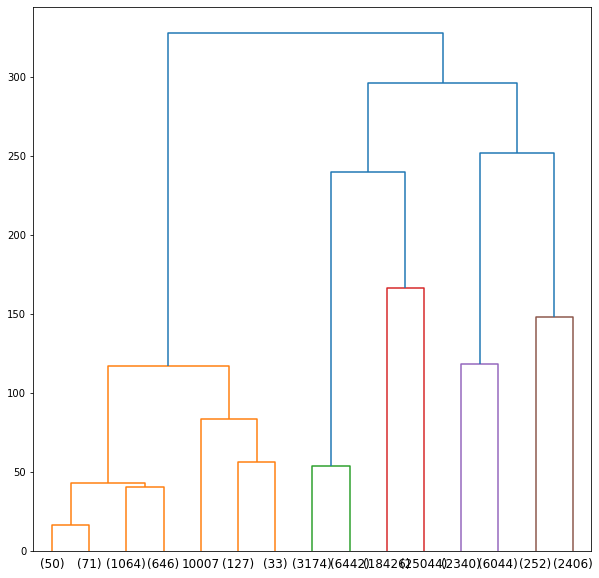

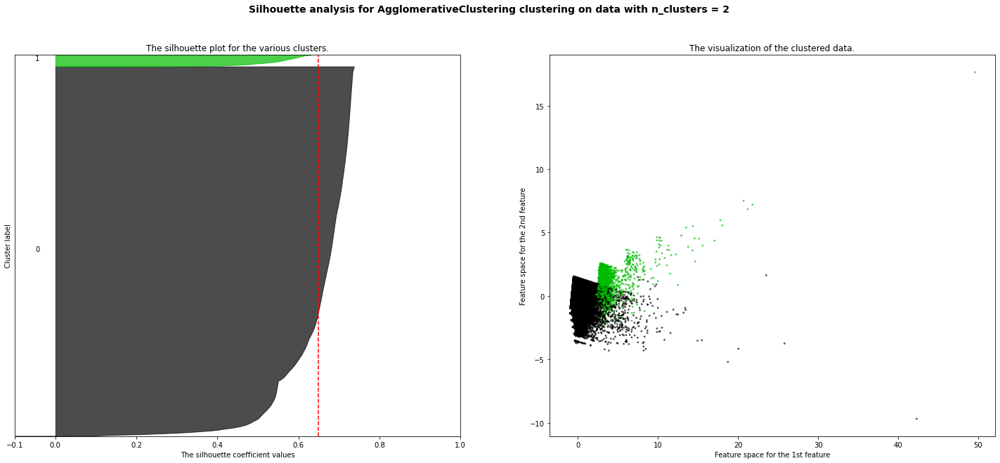

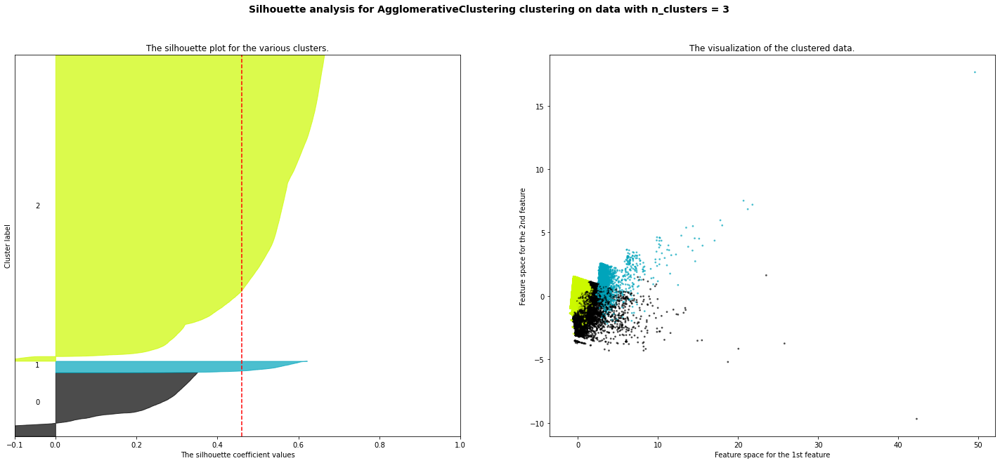

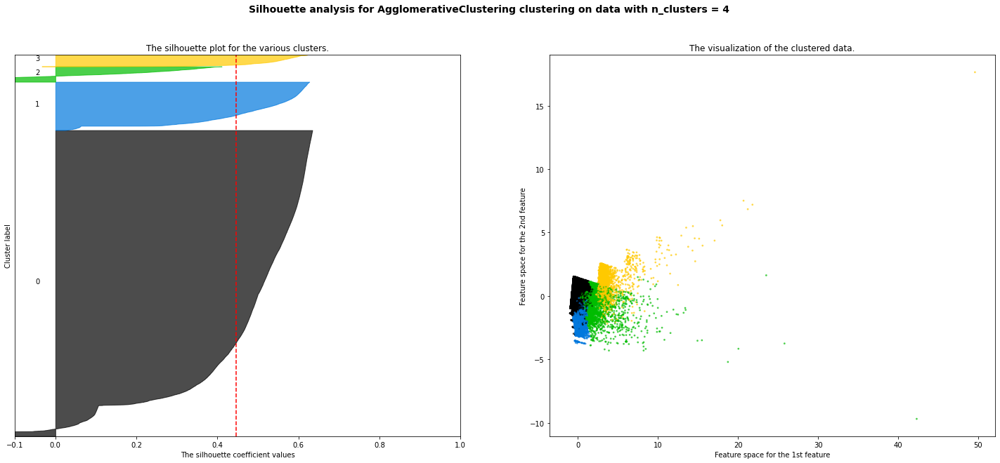

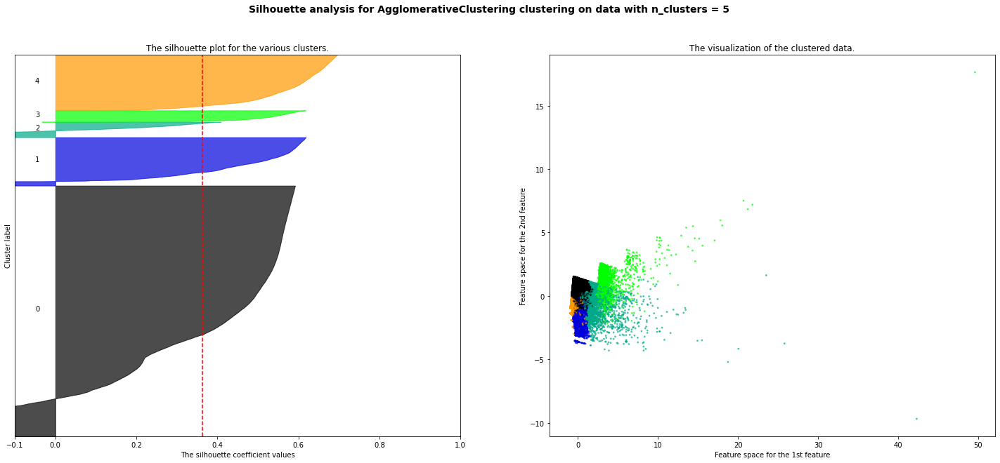

...

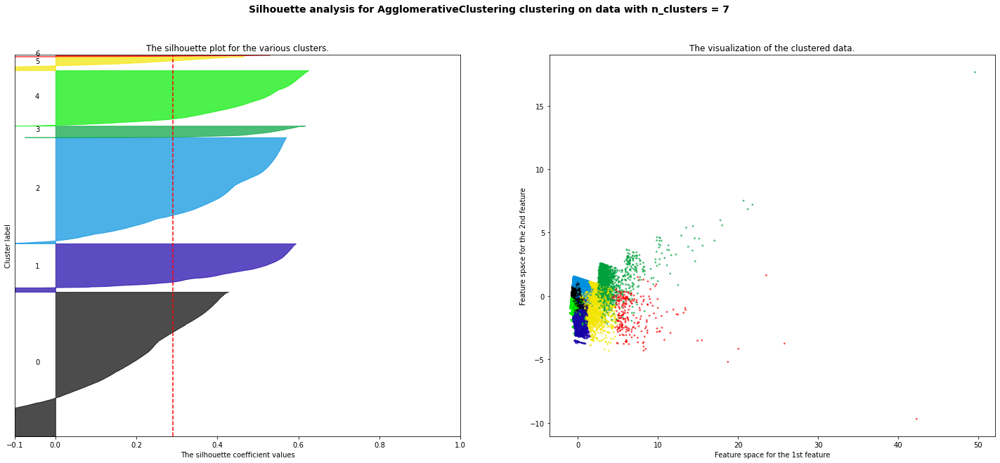

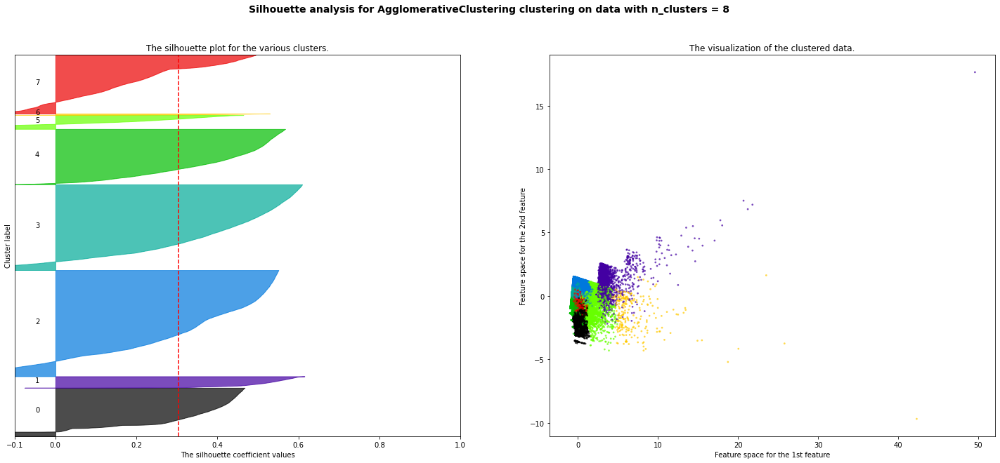

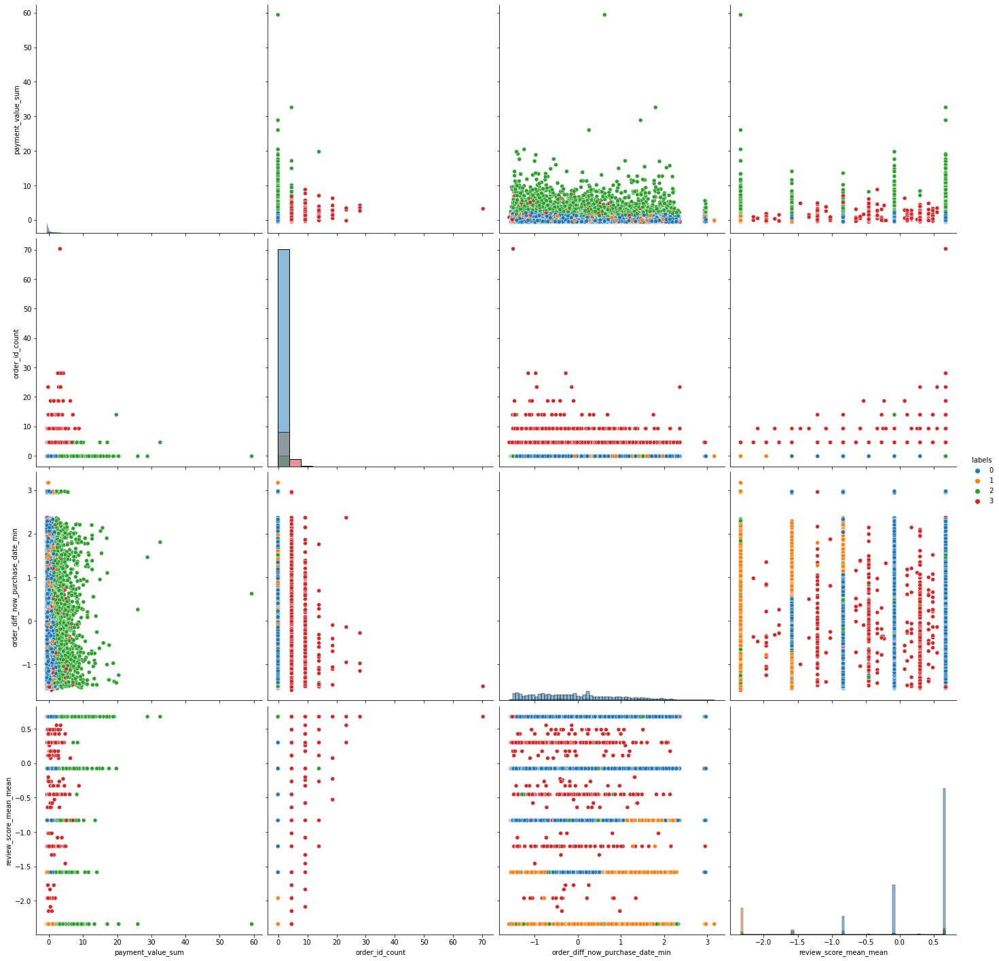

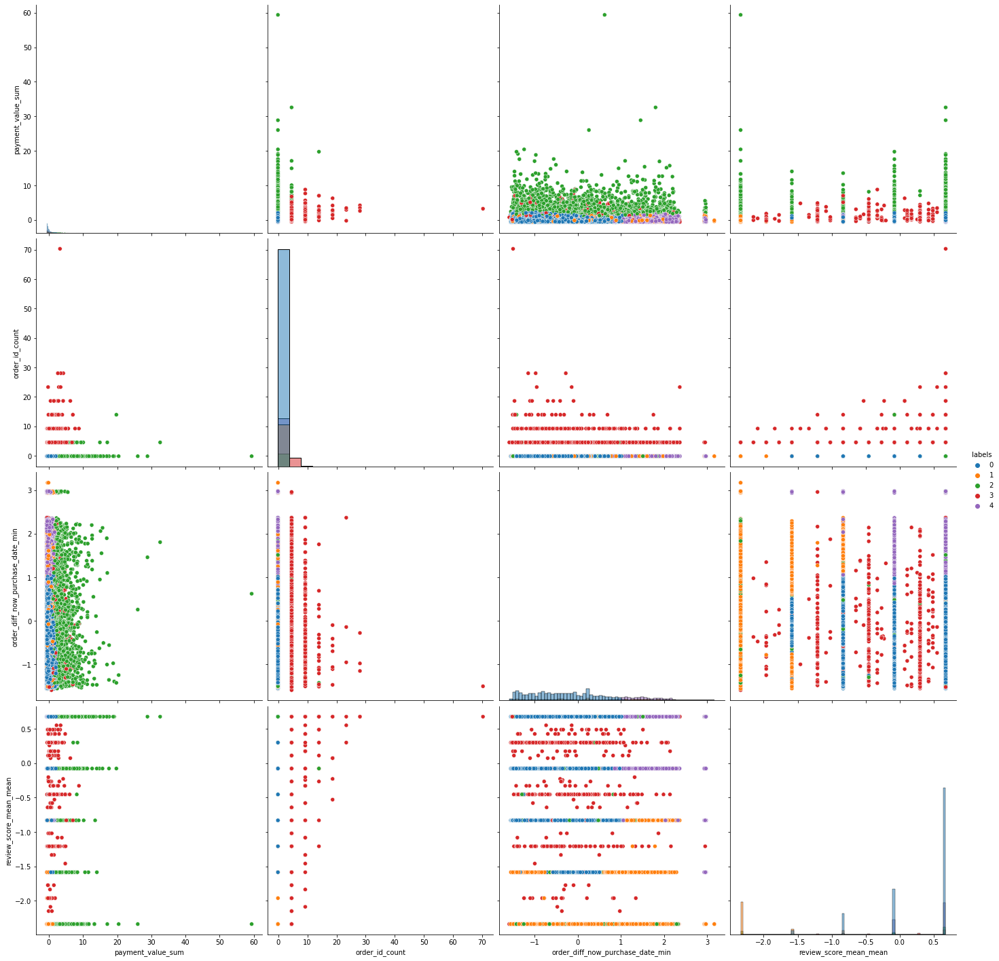

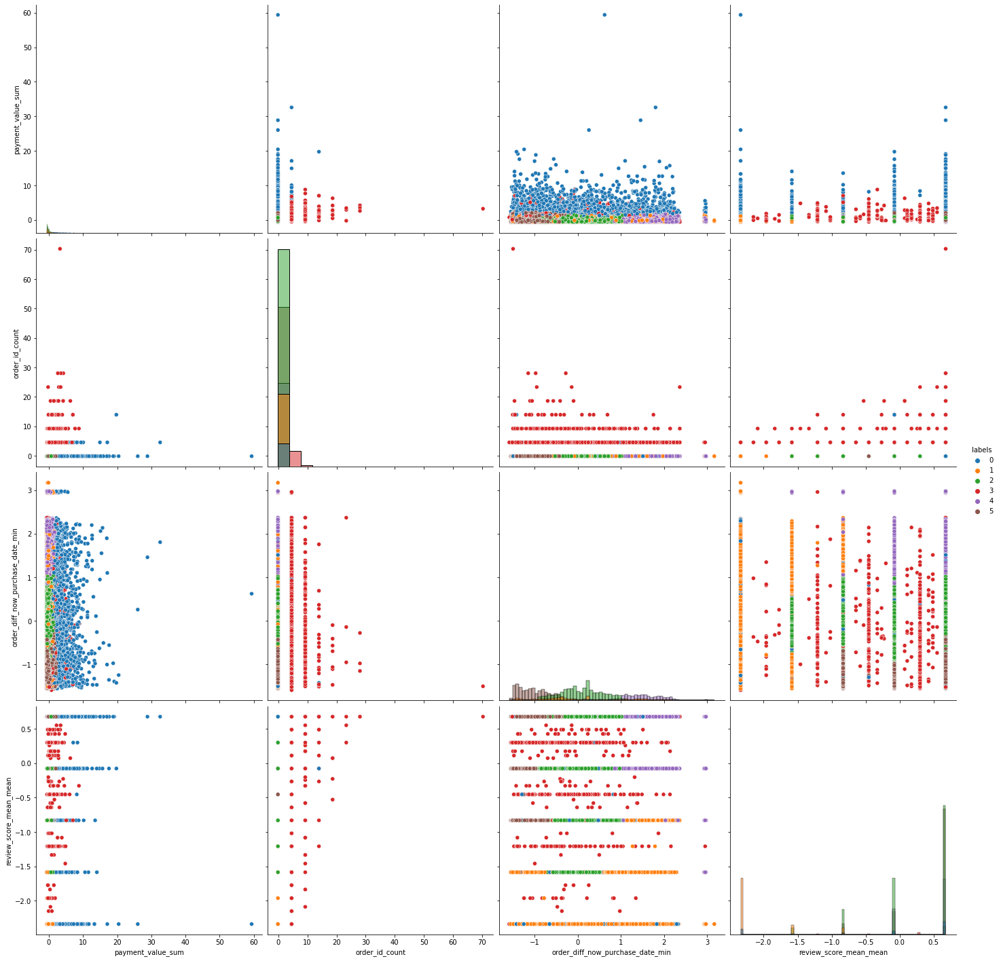

In [12]:
# WARD
from src.cluster import dataHelper, agglomerativeClusturingHelper

columns = [
    'payment_value_sum',
    'order_id_count',
    'order_diff_now_purchase_date_min',
    'review_score_mean_mean'
]
_df = df.sample(frac=0.7)

data_helper = dataHelper(df=_df[columns], limit=limit)
agglomerative_clusturing_helper = agglomerativeClusturingHelper(data=data_helper)

agglomerative_clusturing_helper.make_model(n=None, params={'linkage': 'ward', 'distance_threshold': 0, 'memory': './cache/'})
agglomerative_clusturing_helper.plot_dendrogram(n=None)

agglomerative_clusturing_helper.make_clusters(nx=range(2,9), params={'linkage': 'ward', 'memory': './cache/'})

agglomerative_clusturing_helper.plot_results(nx=range(2,9))

agglomerative_clusturing_helper.plot_relationship(n=4)
agglomerative_clusturing_helper.plot_relationship(n=5)
agglomerative_clusturing_helper.plot_relationship(n=6)

### Agglomerative Clustering (average)

Making clusters: None
Making clusters: 2
Making clusters: 3
Making clusters: 4
Making clusters: 5
Making clusters: 6
Making clusters: 7
Making clusters: 8
For 2 clusters, The average silhouette_score is : 0.9673371882134773
For 3 clusters, The average silhouette_score is : 0.9620886113869259
For 4 clusters, The average silhouette_score is : 0.921278407125393
For 5 clusters, The average silhouette_score is : 0.9018377085054049
For 6 clusters, The average silhouette_score is : 0.9011674299629816
For 7 clusters, The average silhouette_score is : 0.8962379312189563
For 8 clusters, The average silhouette_score is : 0.7771891894667409


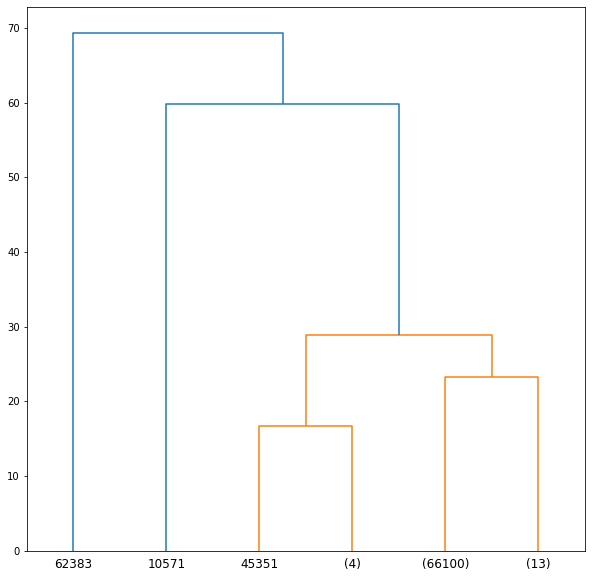

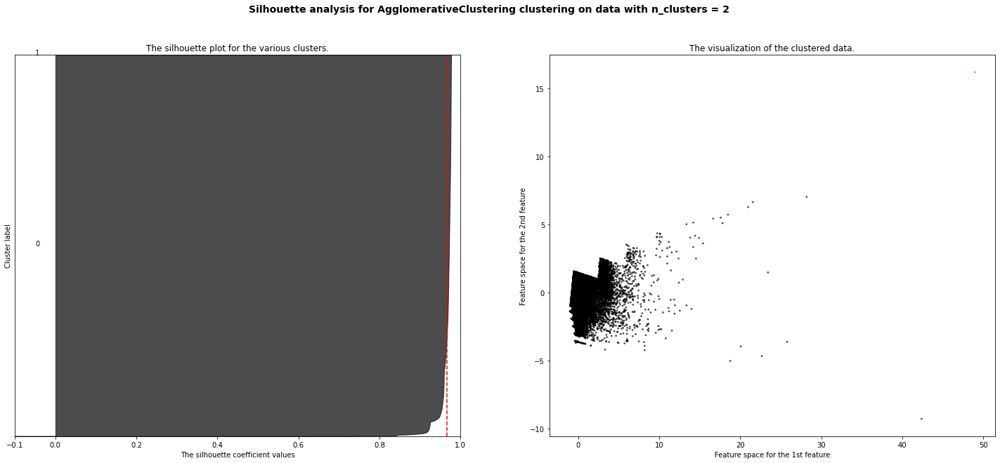

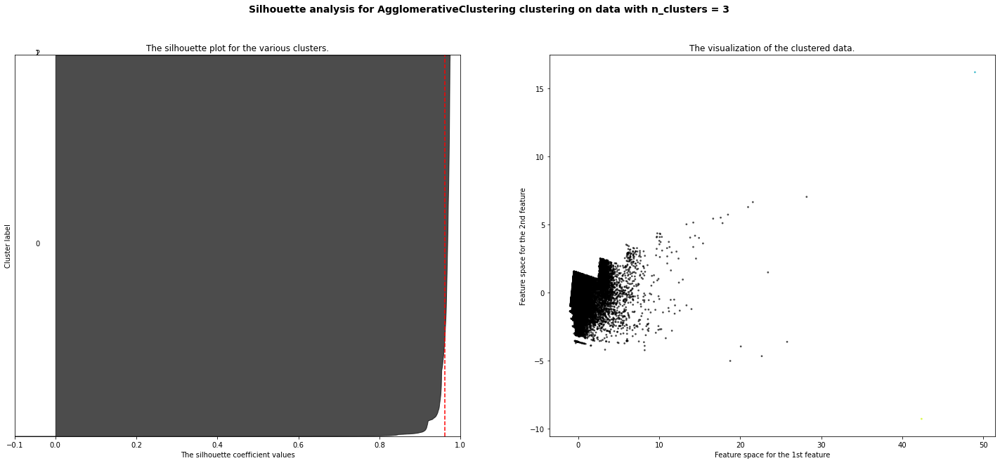

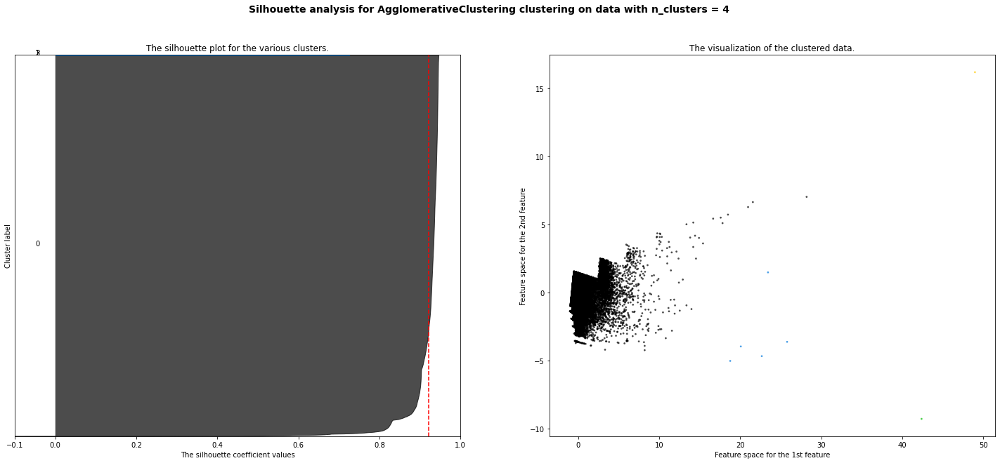

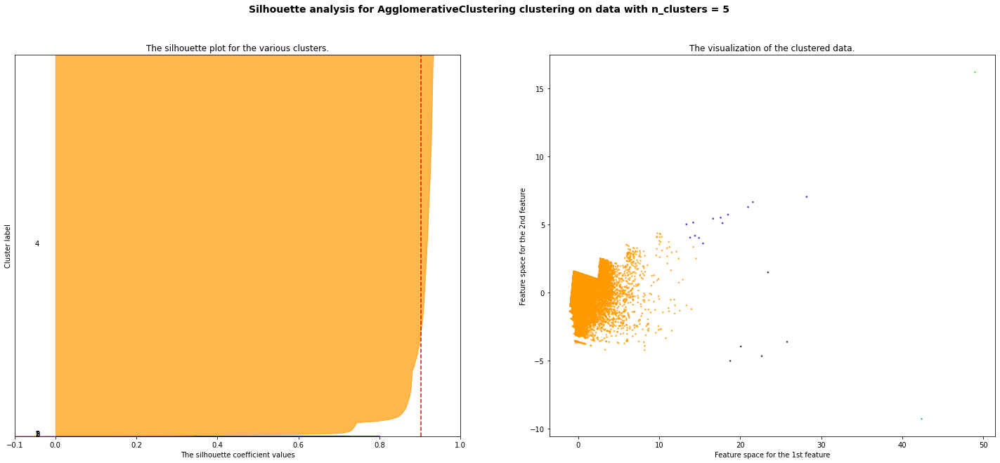

...

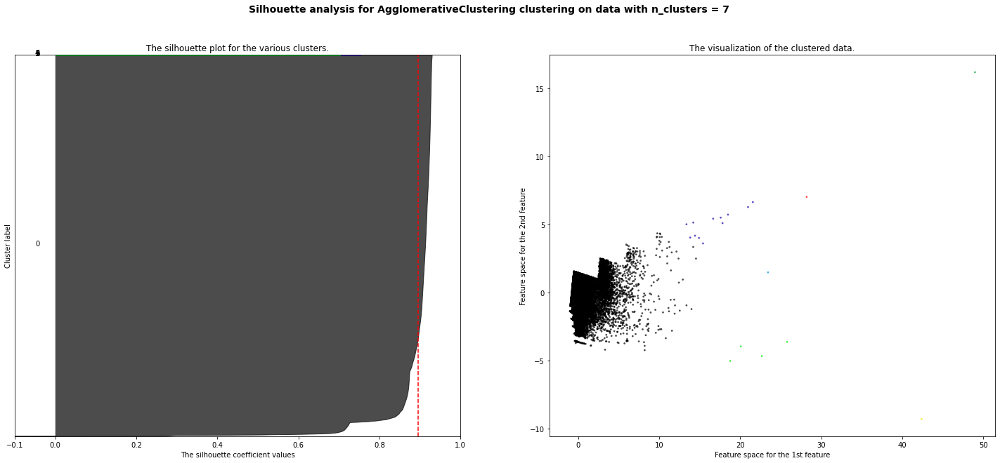

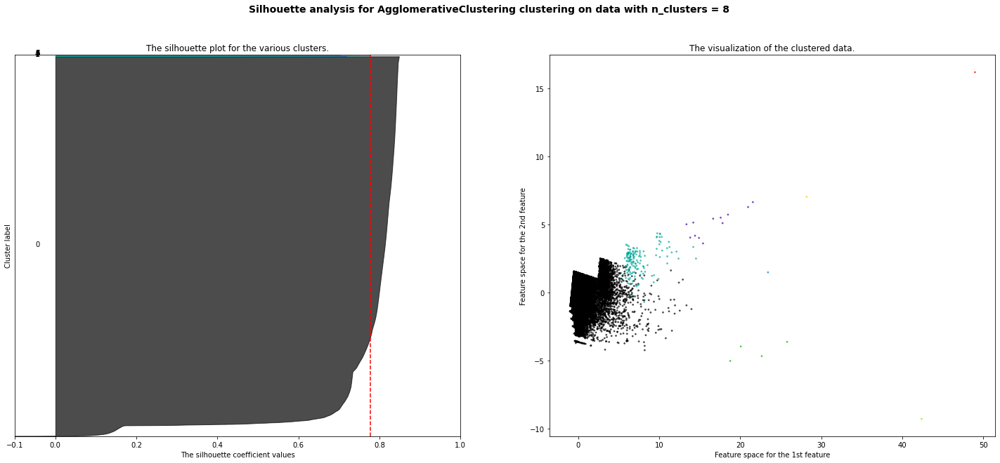

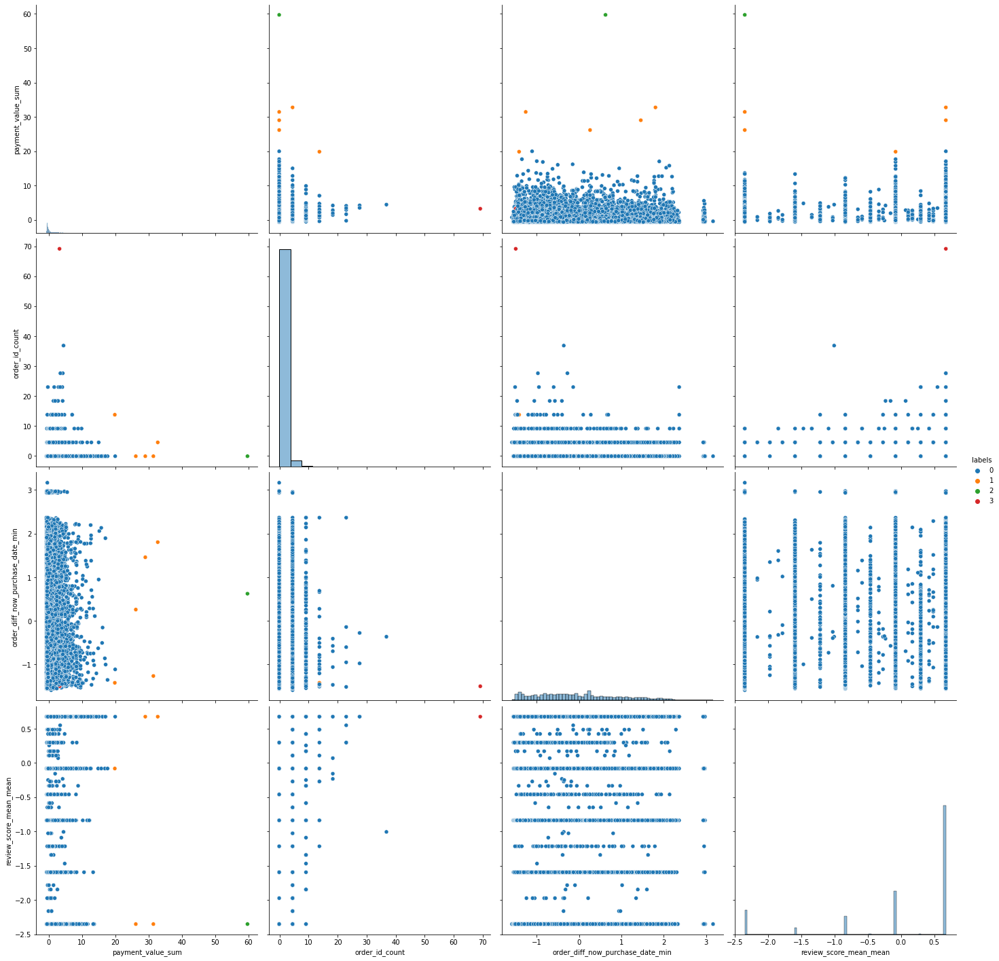

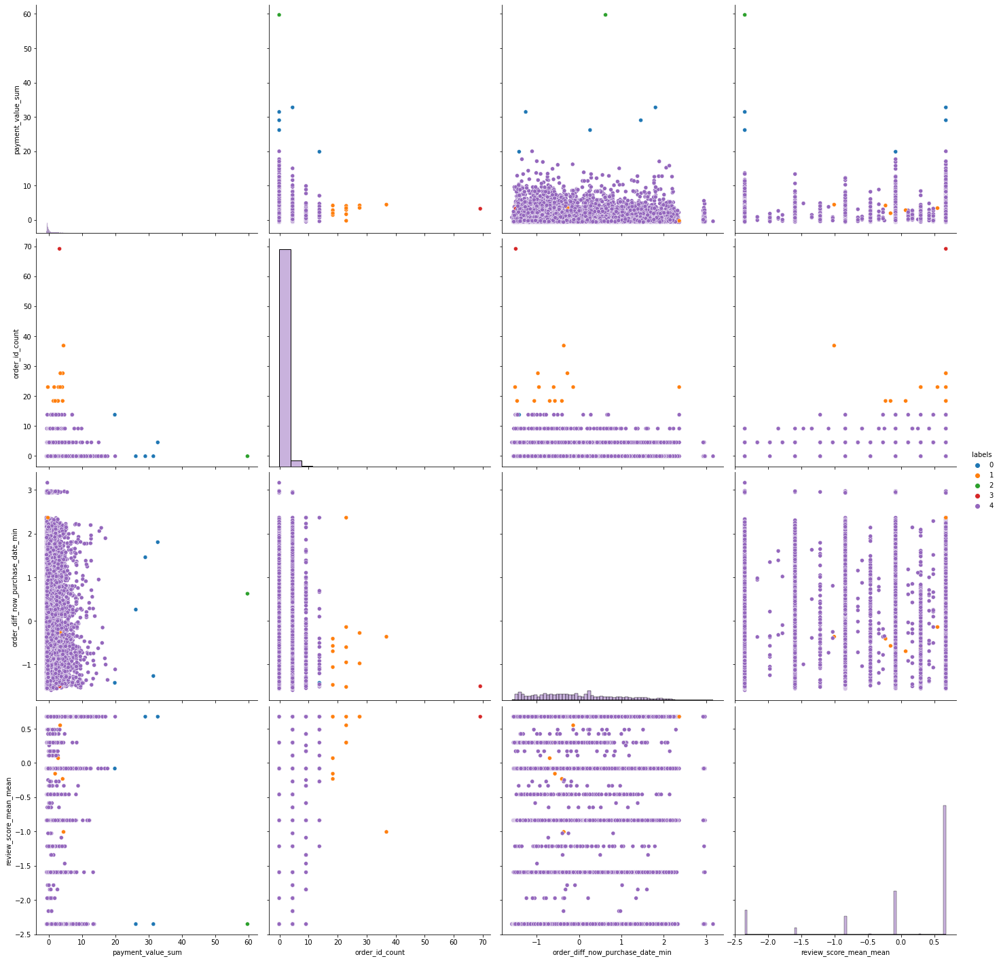

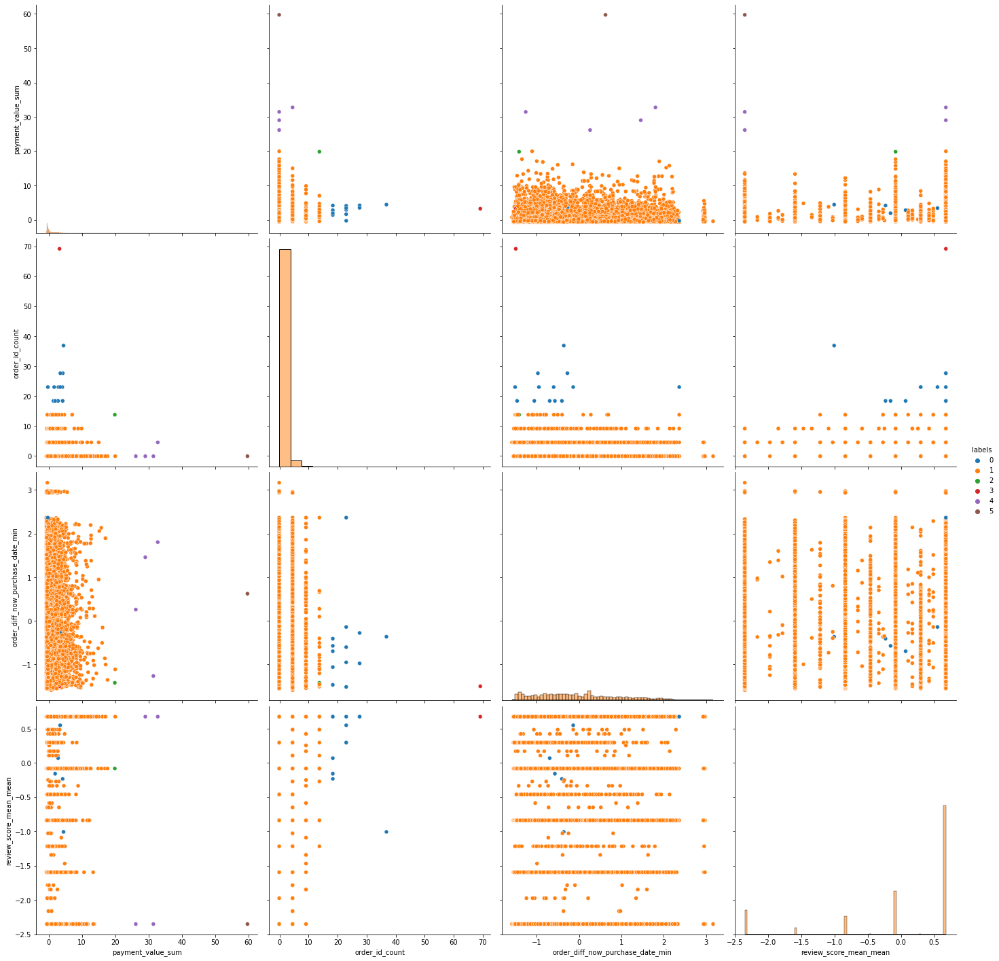

In [13]:
# Average
from src.cluster import dataHelper, agglomerativeClusturingHelper

columns = [
    'payment_value_sum',
    'order_id_count',
    'order_diff_now_purchase_date_min',
    'review_score_mean_mean'
]
_df = df.sample(frac=0.7)

data_helper = dataHelper(df=_df[columns], limit=limit)
agglomerative_clusturing_helper = agglomerativeClusturingHelper(data=data_helper)

agglomerative_clusturing_helper.make_model(n=None, params={'linkage': 'average', 'distance_threshold': 0, 'memory': './cache/'})
agglomerative_clusturing_helper.plot_dendrogram(n=None)

agglomerative_clusturing_helper.make_clusters(nx=range(2,9), params={'linkage': 'average', 'memory': './cache/'})

agglomerative_clusturing_helper.plot_results(nx=range(2,9))

agglomerative_clusturing_helper.plot_relationship(n=4)
agglomerative_clusturing_helper.plot_relationship(n=5)
agglomerative_clusturing_helper.plot_relationship(n=6)

### Export du notebook en HTML

In [14]:
!jupyter nbconvert --config nbconvert/config_html.py

[NbConvertApp] Converting notebook P5_01_notebooknettoyage.ipynb to html
[NbConvertApp] Writing 614907 bytes to P5_01_notebooknettoyage.html
[NbConvertApp] Converting notebook P5_02_notebookanalyse.ipynb to html
[NbConvertApp] Writing 26124588 bytes to P5_02_notebookanalyse.html
[NbConvertApp] Converting notebook P5_03_notebookproduction.ipynb to html
[NbConvertApp] Writing 906647 bytes to P5_03_notebookproduction.html
